In [ ]:
### IMPORT SCIENTIFIC LIBRARIES ###
import numpy as np
import pandas as pd
from scipy import sparse
from scipy.optimize import curve_fit
import importlib

import matplotlib.pyplot as plt
#import seaborn as sns
plt.rcParams['font.size'], plt.rcParams['axes.labelsize'] = 14, 18
#%matplotlib widget

from tqdm import tqdm
import io, sys
from contextlib import redirect_stdout, redirect_stderr

import os

import h5py
import hdf5plugin

import sys
sys.path.append('./XPCS_library/')

import ID10_tools as ID10
from ID10_tools import Nx, Ny, Npx
importlib.reload(ID10)
ID10.set_version('v2')

import XPCS_tools as XPCS
from XPCS_tools import E2lambda, lambda2E, theta2Q, Q2theta, decorelation_f
importlib.reload(XPCS)
XPCS.set_beamline('ID10')

import COSMICRAY_tools as COSMIC
importlib.reload(COSMIC)
COSMIC.set_beamline('ID10')

# RAW FOLDER PATH
raw_folder = '../RAW_DATA/'
masks_folder = '../masks/'
fit_outs_folder = './data/fit_outs/'
Idts_folder = './data/Idts/'
g2_folder = './data/g2/'

# EXPERIMENTAL VARIABLES
XPCS.set_expvar(1350, 1350, 7)
ID10.Nfmax_dense_file = 2000
ID10.Nfmax_sparse_file = 5000

## Load masks

In [2]:
e4m_htmask = np.load(masks_folder+'e4m_htmask_copper_foil_30um_1_1'+'.npy')
e4m_mask = np.load(masks_folder+'e4m_mask'+'.npy')
#bs_mask = np.load(masks_folder+'bs_mask_copper_foil_30um'+'.npy')  # beam-stop mask

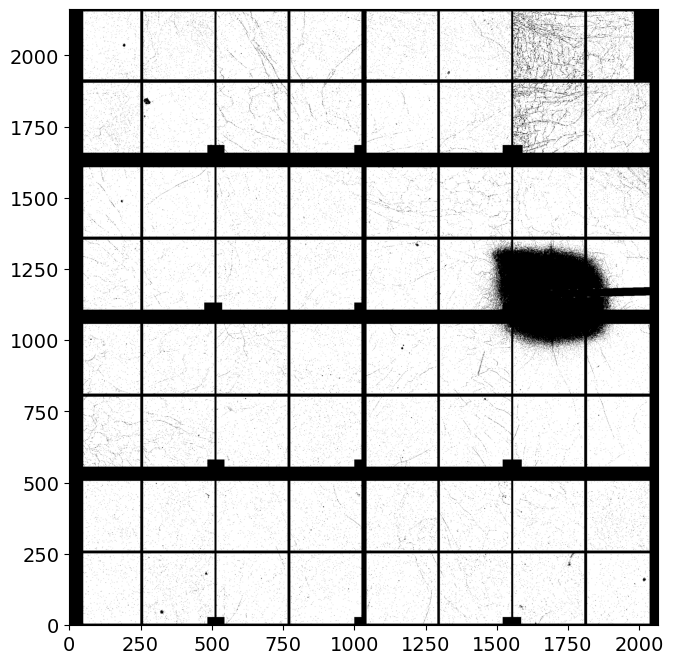

In [3]:
plt.figure(figsize=(8, 8))
plt.imshow((e4m_mask*e4m_htmask).reshape(Nx,Ny), cmap='gray', origin='lower')

### BS mask and Q definition
Using a random scan in GeO2_6, because we are not changing the measurement configuration

#### Beamstop mask

In [4]:
#######################################
sample_name = 'GeO2_6'
Ndataset = 1
Nscan =12
Nfi, Nff = 0, 1000
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

#############################
command = mtimescan 0.02 1 220000
Ei = 9.699998837562536
itime = 0.0201
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/1 loops)
Done!
Concatenating vectors ...
Done!
	 | Sparse array loaded from ../RAW_DATA/GeO2_6/GeO2_6_0001/scan0012/
	 | Shape:       (1000, 4471016)
	 | Sparsity:     3.8e-03
	 | Memory usage (scipy.csr_array): 0.192 GB (np.array usage: 16.656 GB)


################################################################################
Maximum count in the hull run -> 4689
# of pixels above Ith_high treshold ->  75 pixels (of 4471016 => 0.0 %)
################################################################################



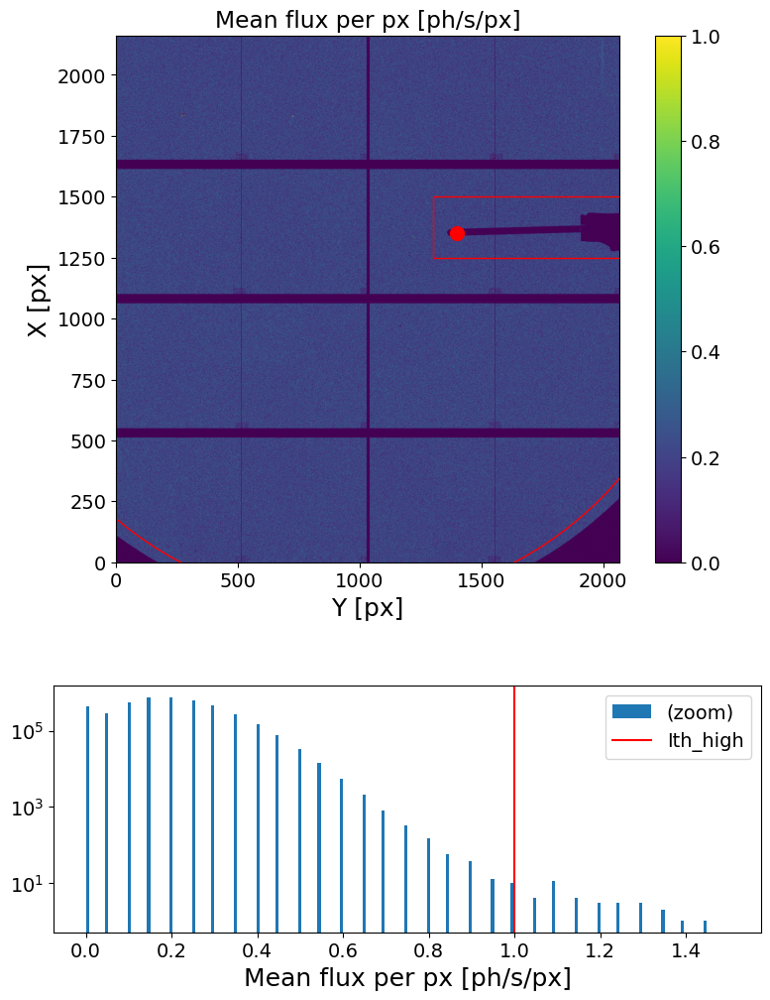

In [5]:
geom = [{'geom':'Rectangle', 'x0':1250, 'y0':1300, 'xl':250, 'yl':1950, 'inside':False},
        {'geom':'Circle', 'Cx':1300, 'Cy':950, 'r':1470, 'inside':True}, 
        ]
XPCS.gen_plots4mask(e4m_data, itime, Ith_high=1, Nff=10000, mask_geom=geom,)

#################################################
Masked area =  93.74594052000708 %
#################################################



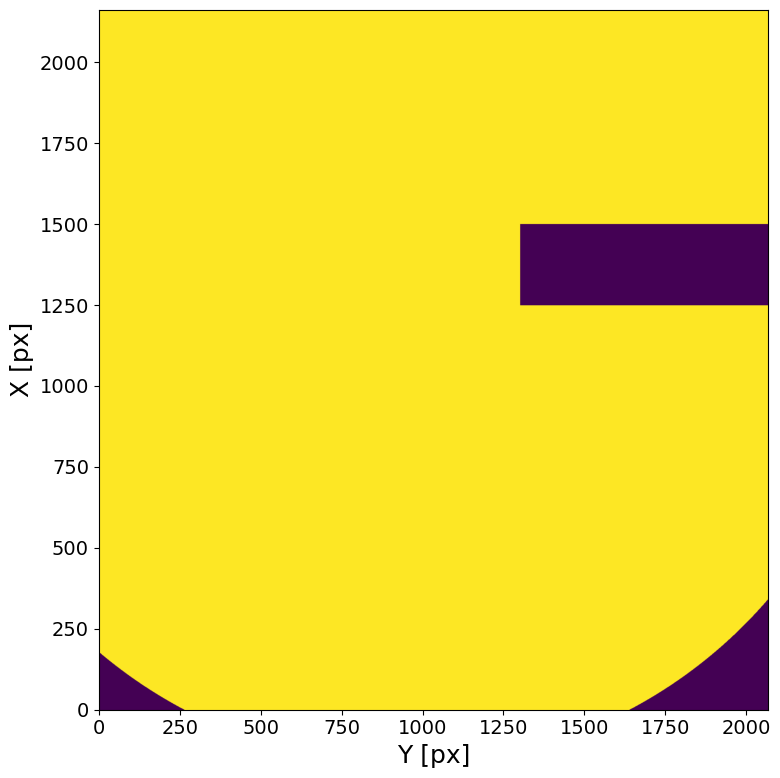

In [6]:
bs_mask = XPCS.gen_mask(e4m_data, itime, e4m_mask=None, mask_geom=geom)

#### Q mask

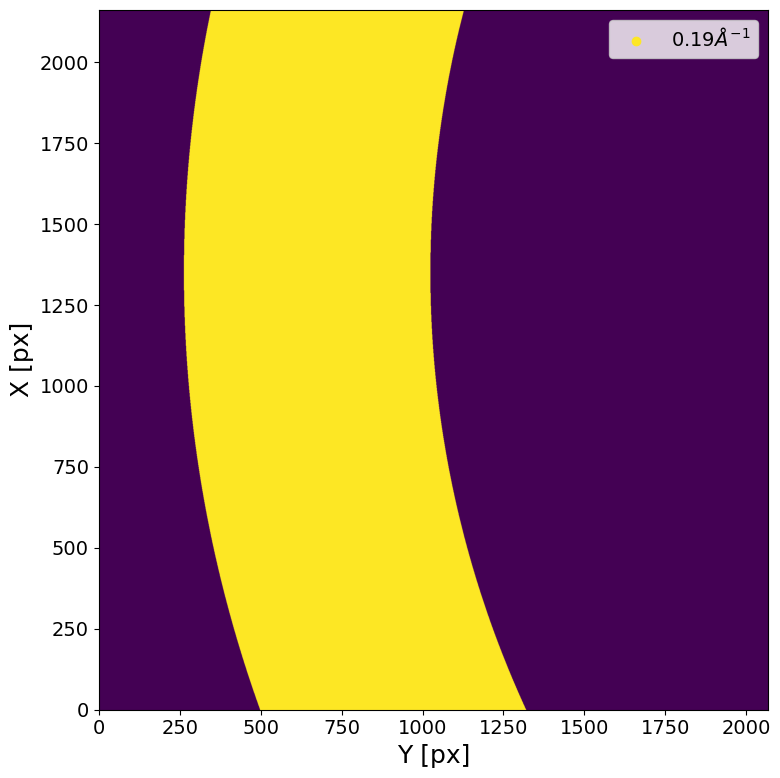

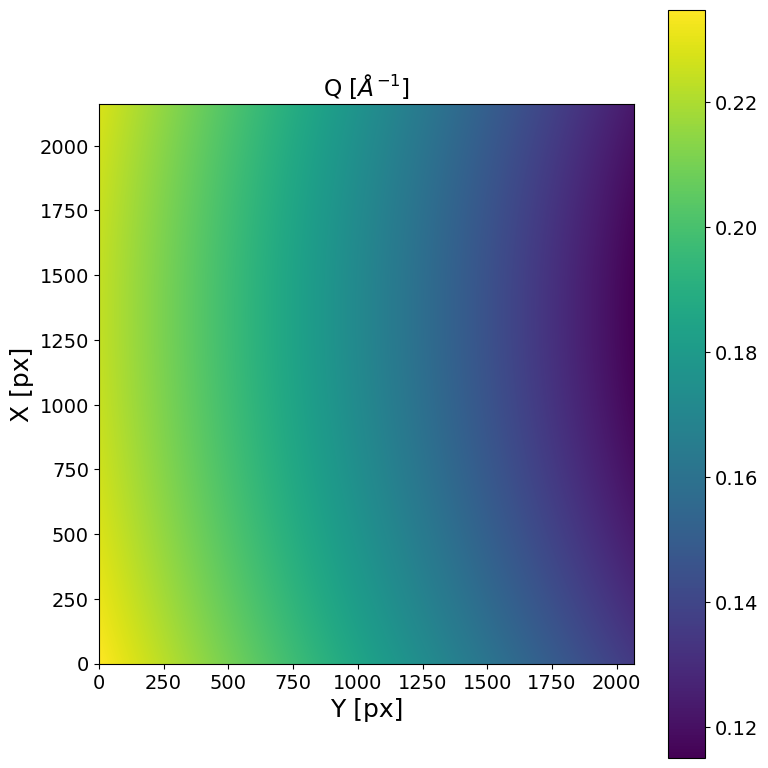

In [7]:
Qmask = XPCS.gen_Qmask(Ei, theta, .19, .02, Qmap_plot=True)

## XPCS scan (T = 30C Q =  0.19 Å, 5 min @ 1ms (300_000 fm)) (GeO2_3_test, dataset 1, scan 1)

In [27]:
#######################################
sample_name = 'GeO2_3_alligment'
Ndataset = 1
Nscan = 6
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 300048
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/61 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/61 loops)
	 -> loadi

KeyboardInterrupt: 

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  81 pixels (of 4471016 => 0.0 %)
################################################################################



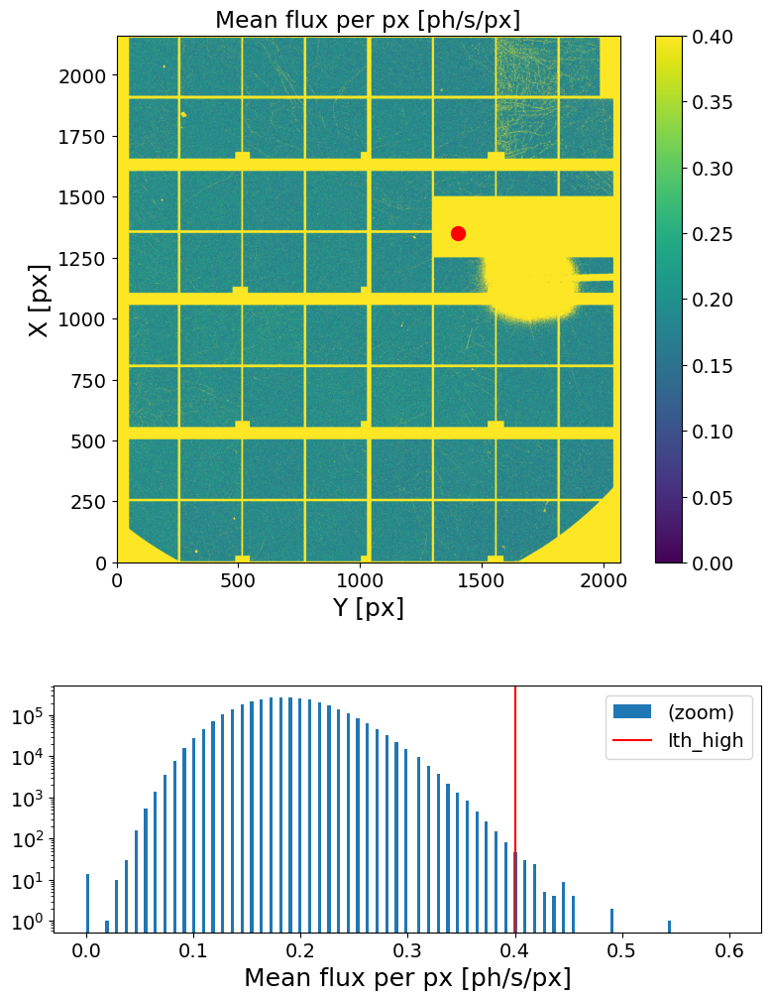

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

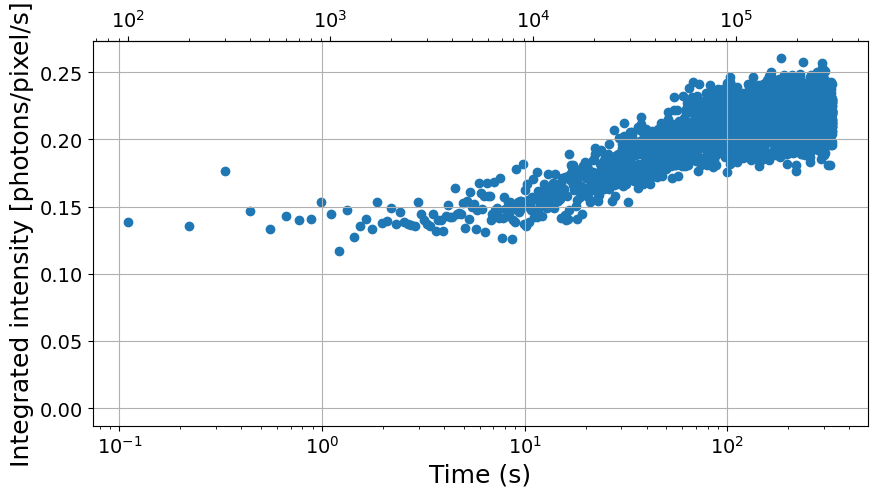

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 5
Nbunch = 2
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 200024 ) ...
Loading frames ...
Done! (elapsed time = 2.48 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 5.05 s)
	 | 20004 frames X 4471016 pixels
	 | sparsity = 1.08e-03
	 | memory usage (sparse.csr_array @ float64) = 1.081 GB
Masking data ...
Done! (elapsed time = 1.32 s)
	 | 20004 frames X 1424709 pixels
	 | sparsity = 1.18e-03
	 | memory usage (sparse.csr_array @ float64) = 0.377 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 2.96 s)
	 | 20004 X 20004 squared matrix
	 | memory usage (np.array @ float64) = 2.981 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 1.22 s)

Done!

Computing G2t for bunch 2 (Nfi = 200024 , Nff = 300048 ) ...
Loading frames ...
Done! (elapsed time = 1.77 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 3.38 s)
	 | 20004 frames X 4471016 pixels
	 | sparsity = 1.10e-03
	 | memory usage (sparse.csr_array @ float64) = 1.097 GB


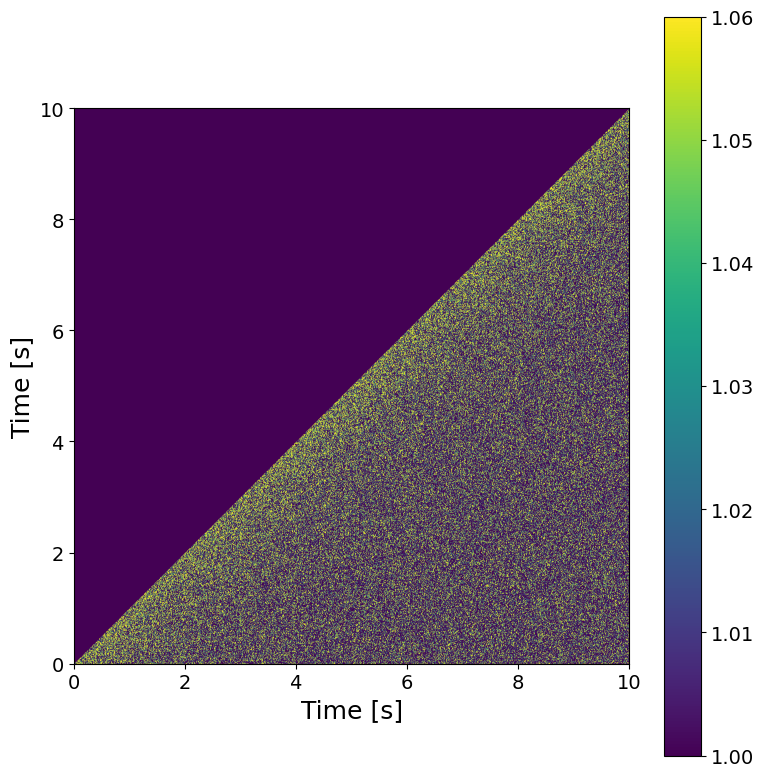

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 0.41 s)



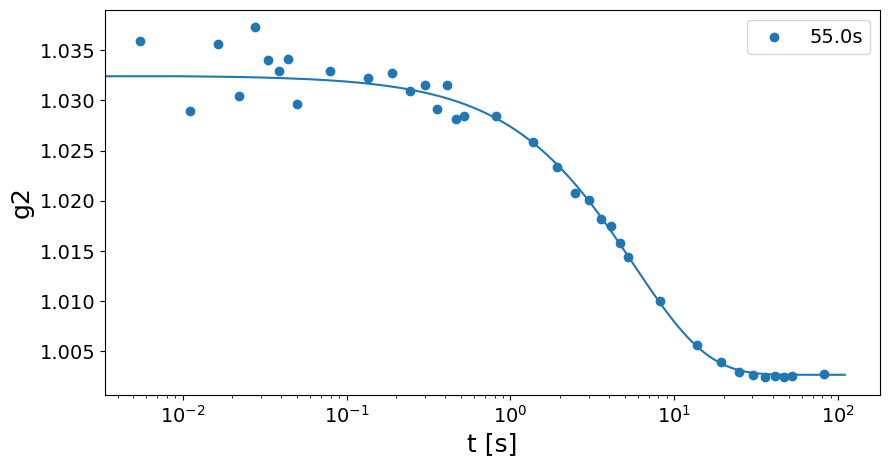

tau = 5.669602068593473 +/- 0.38367574766871443
beta = 0.9659040603760572 +/- 0.07115710373089104
c = 0.02983093037029775 +/- 0.0014008554530410132
y0 = 1.0026431246984533 +/- 0.00010753367196494239


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 30C Q =  0.19 Å, 25 min @ 1ms (1_500_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_30C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, 900_000
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 1500240
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/181 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/181 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  21 pixels (of 4471016 => 0.0 %)
################################################################################



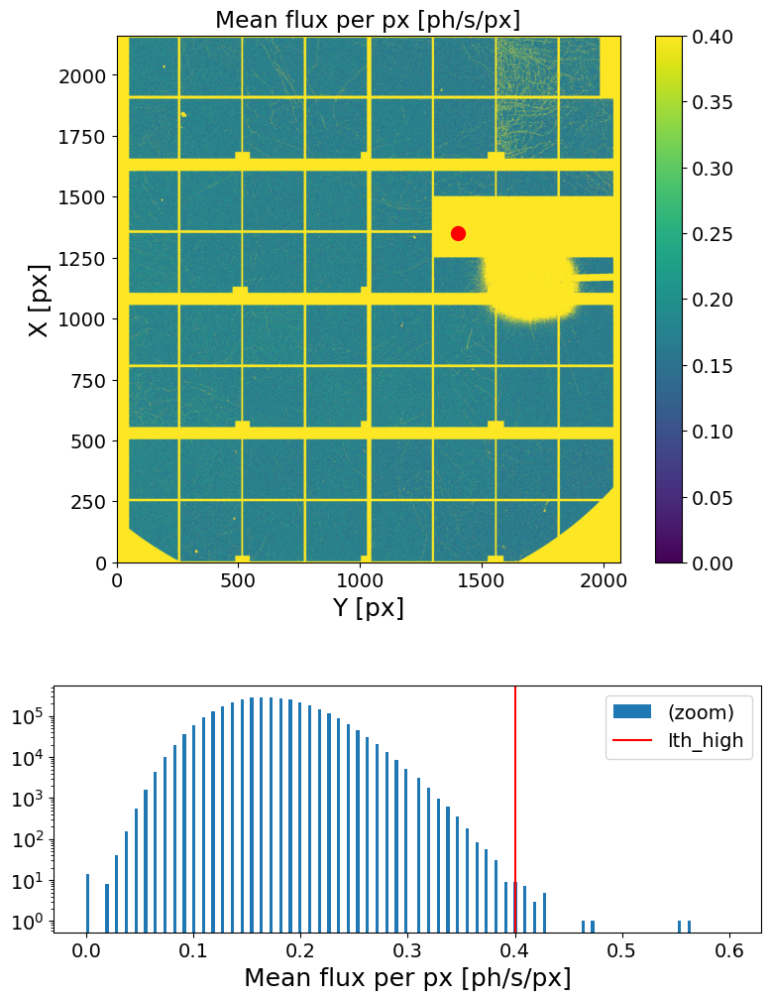

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

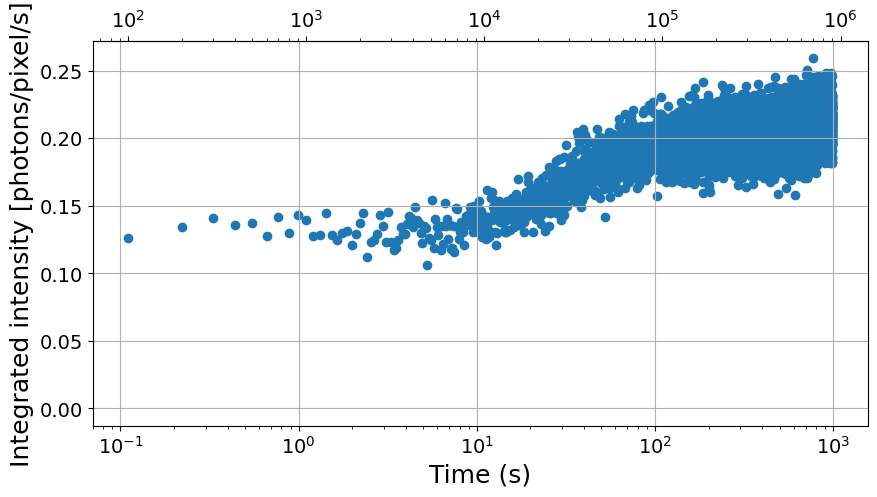

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 30
Nbunch = 3
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 366666 ) ...
Loading frames ...
Done! (elapsed time = 1.61 s)
Binning frames (Lbin = 30, using MKL library) ...
Done! (elapsed time = 5.31 s)
	 | 8888 frames X 4471016 pixels
	 | sparsity = 6.02e-03
	 | memory usage (sparse.csr_array @ float64) = 2.673 GB
Masking data ...
Done! (elapsed time = 2.78 s)
	 | 8888 frames X 1424709 pixels
	 | sparsity = 6.60e-03
	 | memory usage (sparse.csr_array @ float64) = 0.934 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 4.48 s)
	 | 8888 X 8888 squared matrix
	 | memory usage (np.array @ float64) = 0.589 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 0.06 s)

Done!

Computing G2t for bunch 2 (Nfi = 366666 , Nff = 633332 ) ...
Loading frames ...
Done! (elapsed time = 1.48 s)
Binning frames (Lbin = 30, using MKL library) ...
Done! (elapsed time = 4.34 s)
	 | 8888 frames X 4471016 pixels
	 | sparsity = 6.10e-03
	 | memory usage (sparse.csr_array @ float64) = 2.71 GB
Mask

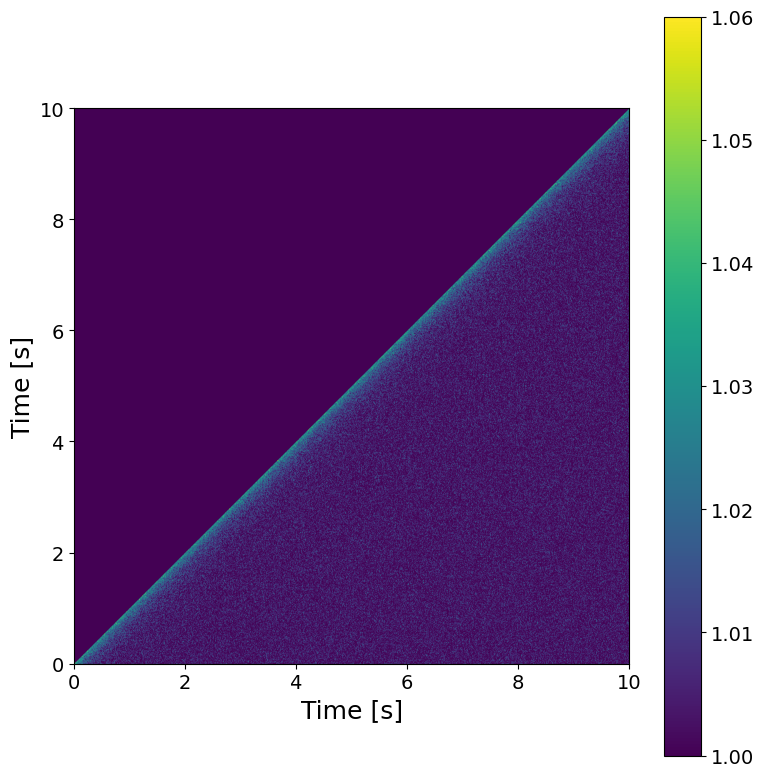

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 0.1 s)



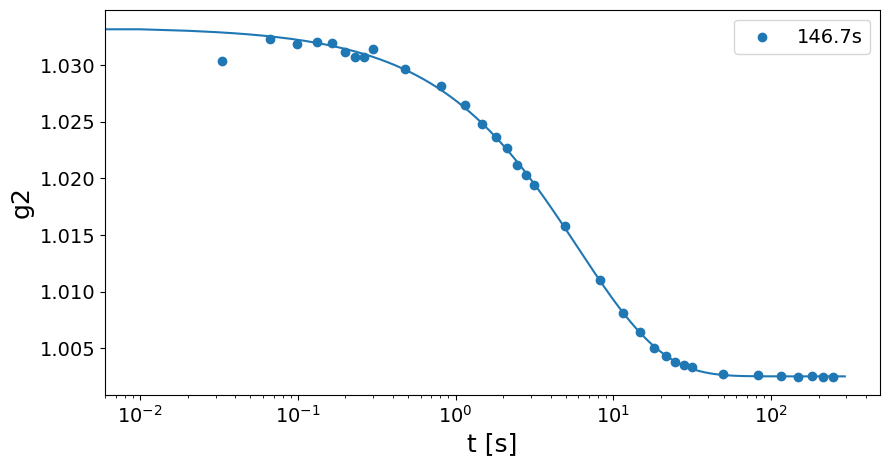

tau = 5.974308821799779 +/- 0.20256397777605503
beta = 0.8092889148548459 +/- 0.022443594331137493
c = 0.03084496525660854 +/- 0.0006365107467555607
y0 = 1.0025037743308658 +/- 2.4953662313915503e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 100C Q =  0.19 Å, 25 min @ 1ms (1_500_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_695C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 1500240
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/301 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  95 pixels (of 4471016 => 0.0 %)
################################################################################



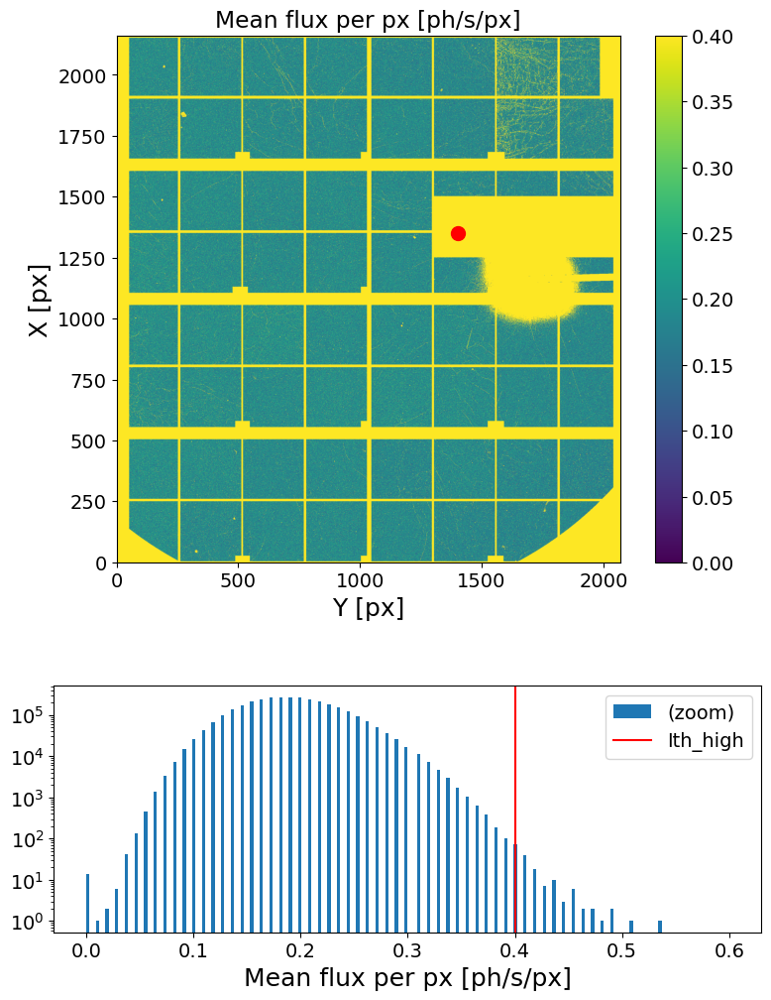

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

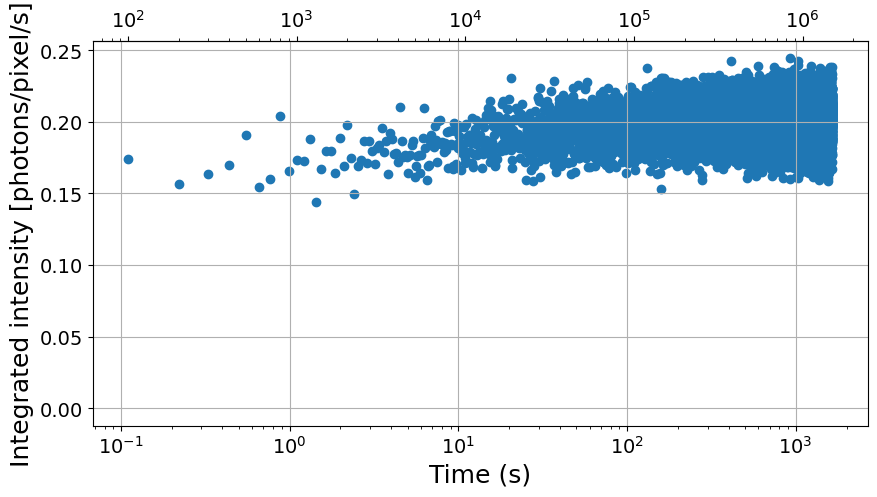

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 3
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 566746 ) ...
Loading frames ...
Done! (elapsed time = 3.69 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 7.89 s)
	 | 46674 frames X 4471016 pixels
	 | sparsity = 1.99e-03
	 | memory usage (sparse.csr_array @ float64) = 4.645 GB
Masking data ...
Done! (elapsed time = 4.33 s)
	 | 46674 frames X 1424709 pixels
	 | sparsity = 2.18e-03
	 | memory usage (sparse.csr_array @ float64) = 1.622 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 12.7 s)
	 | 46674 X 46674 squared matrix
	 | memory usage (np.array @ float64) = 16.231 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 6.32 s)

Done!

Computing G2t for bunch 2 (Nfi = 566746 , Nff = 1033492 ) ...
Loading frames ...
Done! (elapsed time = 3.65 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 15.06 s)
	 | 46674 frames X 4471016 pixels
	 | sparsity = 1.99e-03
	 | memory usage (sparse.csr_array @ float64) = 4.63

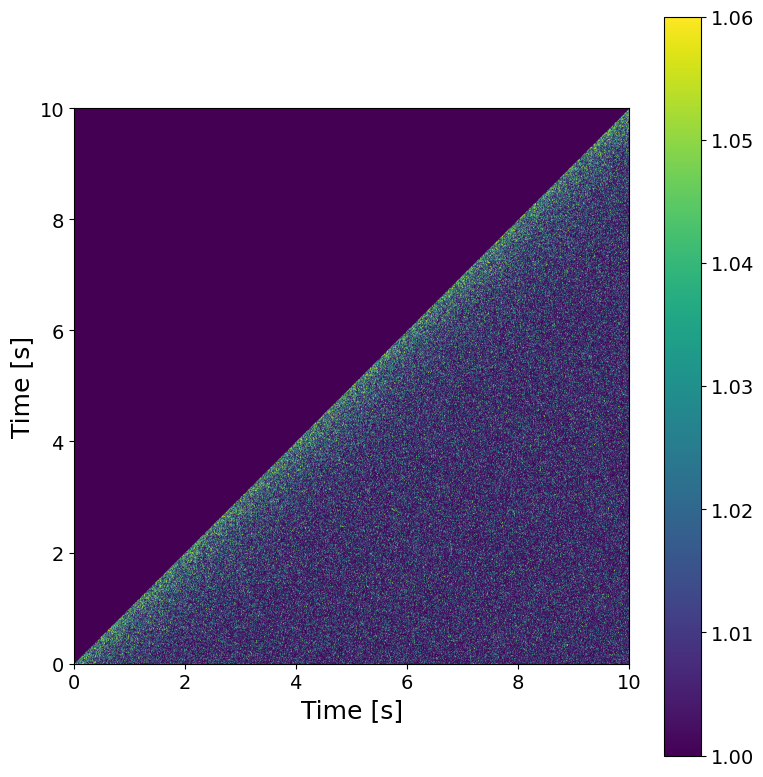

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 2.52 s)



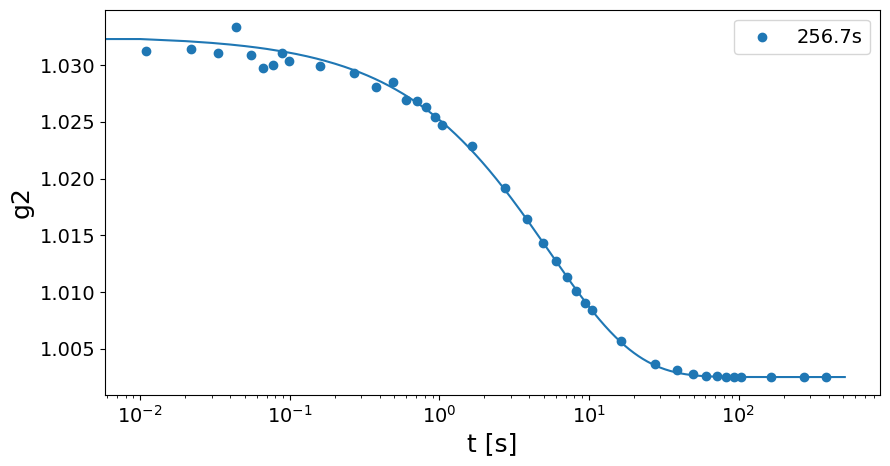

tau = 5.43123773167206 +/- 0.18062370121199017
beta = 0.7478104257411111 +/- 0.017920849367602663
c = 0.03004405261365368 +/- 0.0005720815869182037
y0 = 1.0025129542049167 +/- 1.5009267962084223e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 170C Q =  0.19 Å, 25 min @ 1ms (1_500_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_170C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 1500240
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/301 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  102 pixels (of 4471016 => 0.0 %)
################################################################################



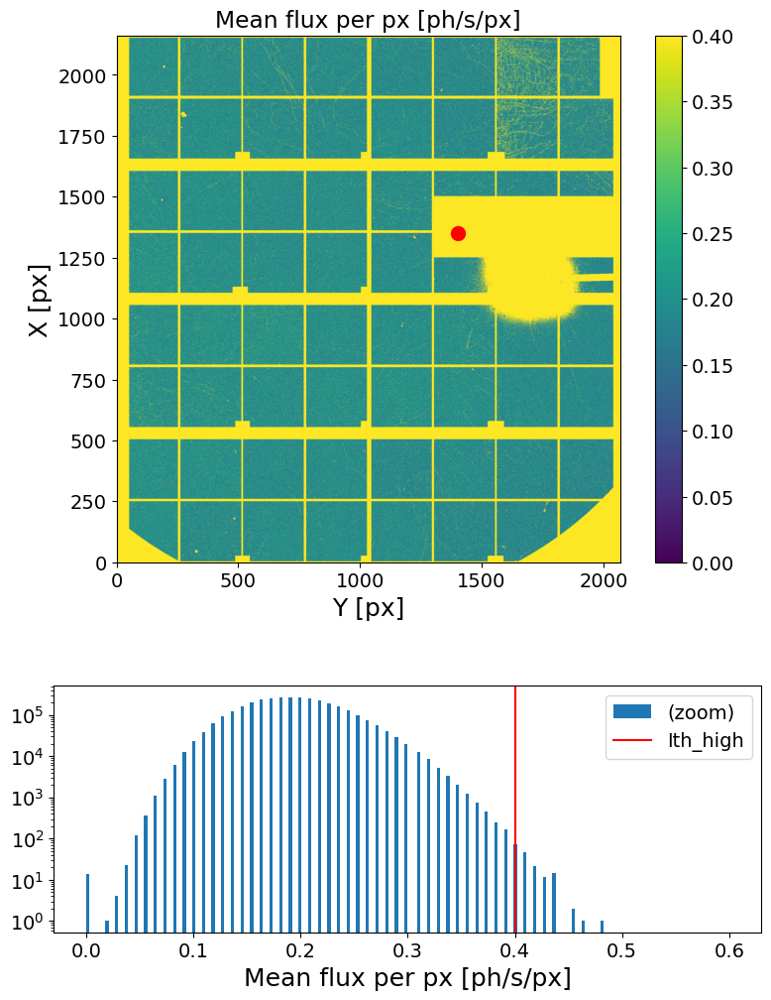

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

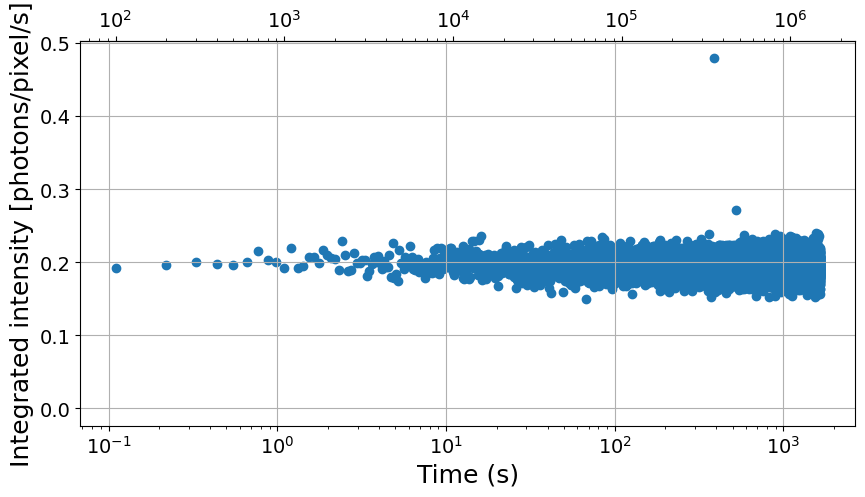

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 10
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 240024 ) ...
Loading frames ...
Done! (elapsed time = 2.55 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 3.89 s)
	 | 14002 frames X 4471016 pixels
	 | sparsity = 1.96e-03
	 | memory usage (sparse.csr_array @ float64) = 1.368 GB
Masking data ...
Done! (elapsed time = 1.68 s)
	 | 14002 frames X 1424709 pixels
	 | sparsity = 2.14e-03
	 | memory usage (sparse.csr_array @ float64) = 0.478 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 2.7 s)
	 | 14002 X 14002 squared matrix
	 | memory usage (np.array @ float64) = 1.461 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 0.73 s)

Done!

Computing G2t for bunch 2 (Nfi = 240024 , Nff = 380048 ) ...
Loading frames ...
Done! (elapsed time = 1.46 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 3.56 s)
	 | 14002 frames X 4471016 pixels
	 | sparsity = 1.95e-03
	 | memory usage (sparse.csr_array @ float64) = 1.367 GB

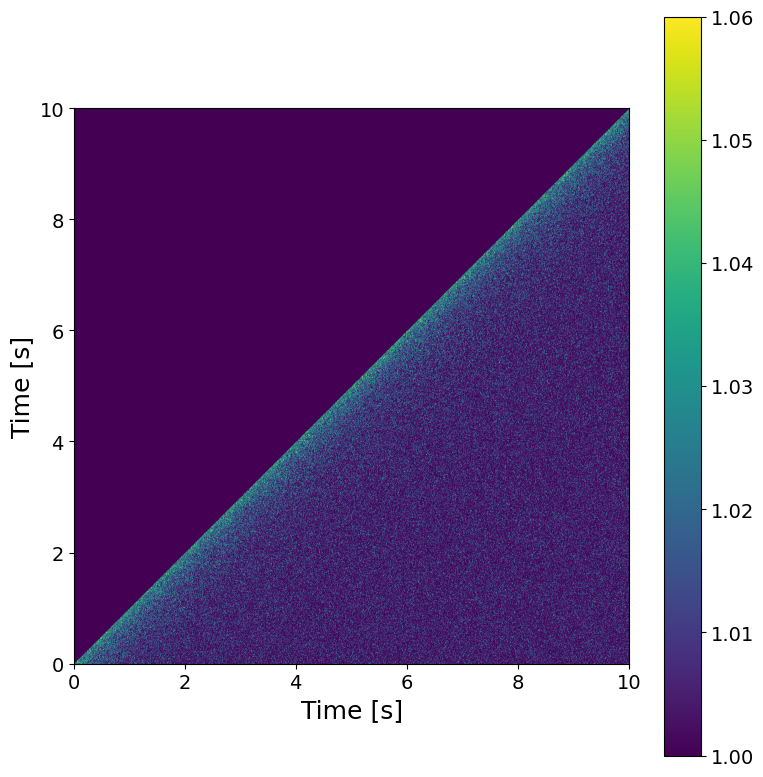

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 0.29 s)



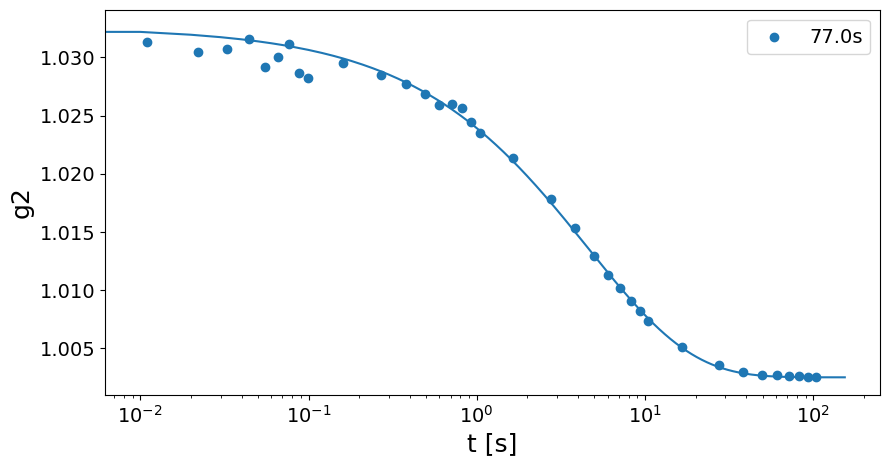

tau = 4.609501311880222 +/- 0.22502547552111354
beta = 0.7065552691490816 +/- 0.023768790219464975
c = 0.03009265910085352 +/- 0.0008239168446927459
y0 = 1.0025009231457074 +/- 3.9477436682799447e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 240C Q =  0.19 Å, 25 min @ 1ms (1_500_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_240C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 1500240
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/301 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  61 pixels (of 4471016 => 0.0 %)
################################################################################



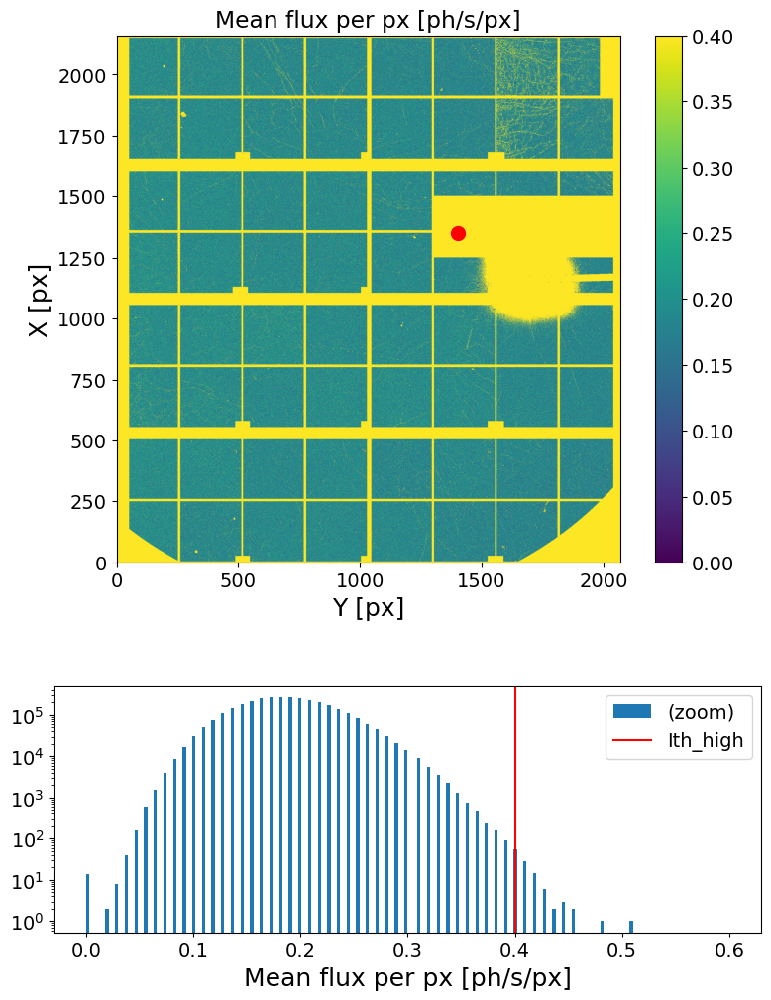

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

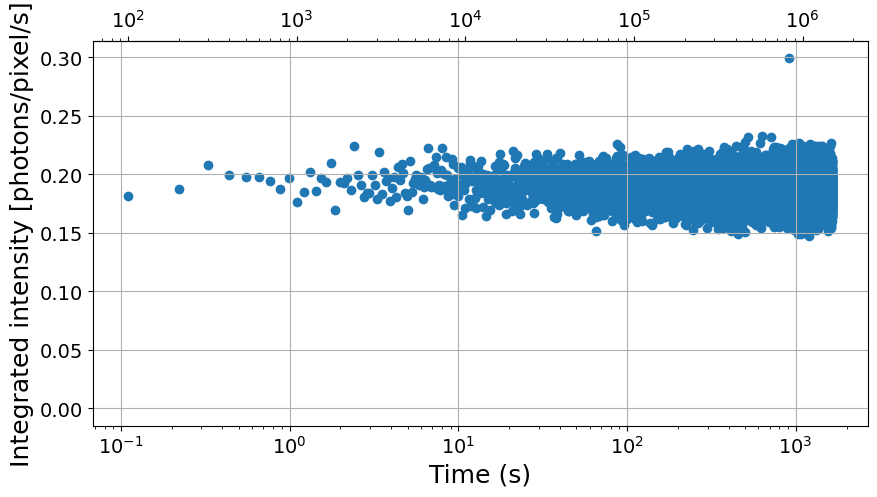

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 10
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 240024 ) ...
Loading frames ...
Done! (elapsed time = 1.4 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 4.39 s)
	 | 14002 frames X 4471016 pixels
	 | sparsity = 1.90e-03
	 | memory usage (sparse.csr_array @ float64) = 1.327 GB
Masking data ...
Done! (elapsed time = 1.18 s)
	 | 14002 frames X 1424709 pixels
	 | sparsity = 2.08e-03
	 | memory usage (sparse.csr_array @ float64) = 0.464 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 2.74 s)
	 | 14002 X 14002 squared matrix
	 | memory usage (np.array @ float64) = 1.461 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 0.83 s)

Done!

Computing G2t for bunch 2 (Nfi = 240024 , Nff = 380048 ) ...
Loading frames ...
Done! (elapsed time = 1.39 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 3.41 s)
	 | 14002 frames X 4471016 pixels
	 | sparsity = 1.89e-03
	 | memory usage (sparse.csr_array @ float64) = 1.325 GB

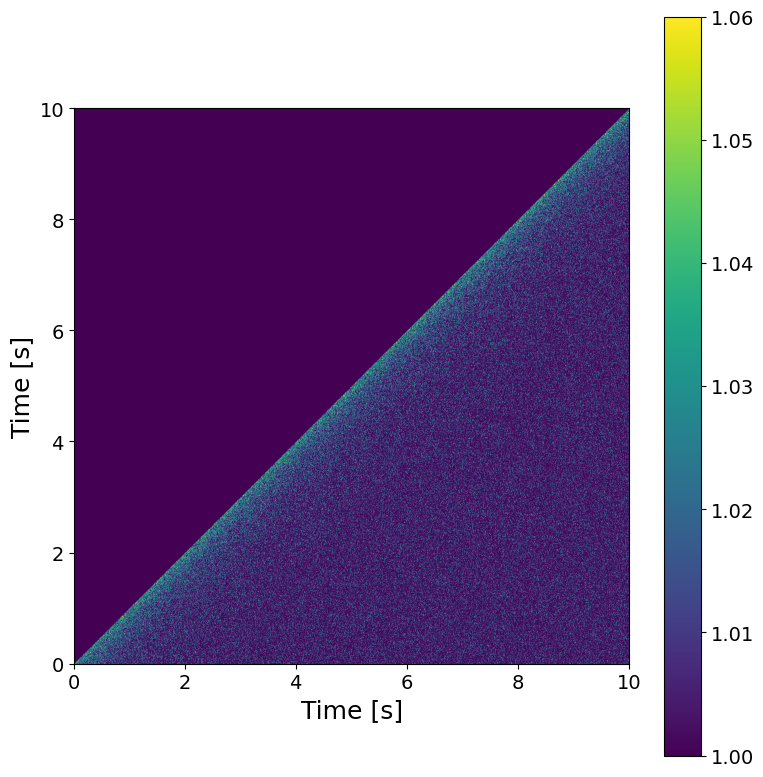

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 0.27 s)



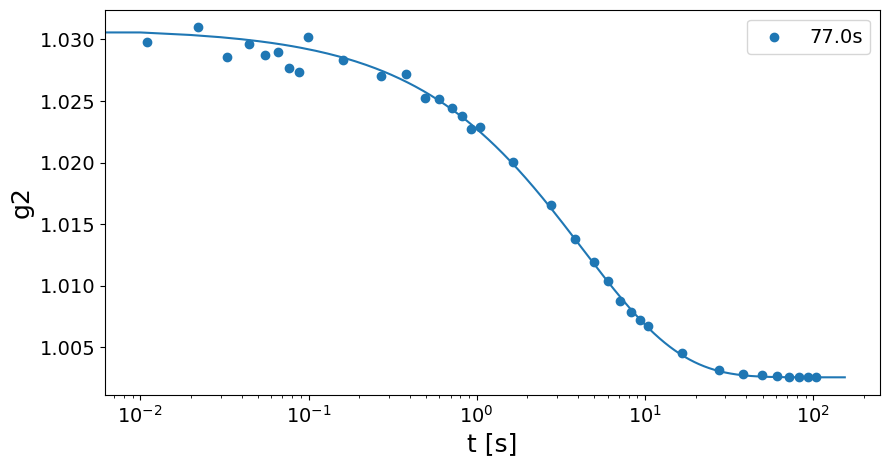

tau = 4.258896830020758 +/- 0.24131828108114983
beta = 0.7454826959943621 +/- 0.031139785987597098
c = 0.028300105832369322 +/- 0.0009284059483925133
y0 = 1.0025696592204556 +/- 4.2710634583689066e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 310C Q =  0.19 Å, 25 min @ 1ms (1_500_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_310C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 1500240
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/301 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/301 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  16 pixels (of 4471016 => 0.0 %)
################################################################################



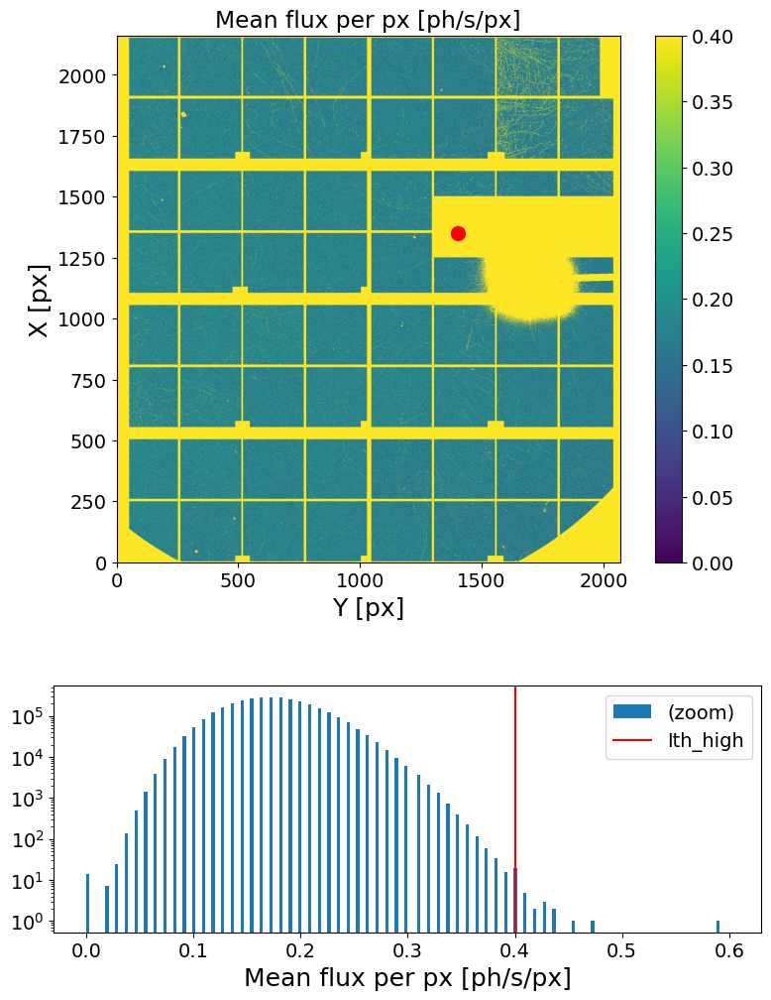

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

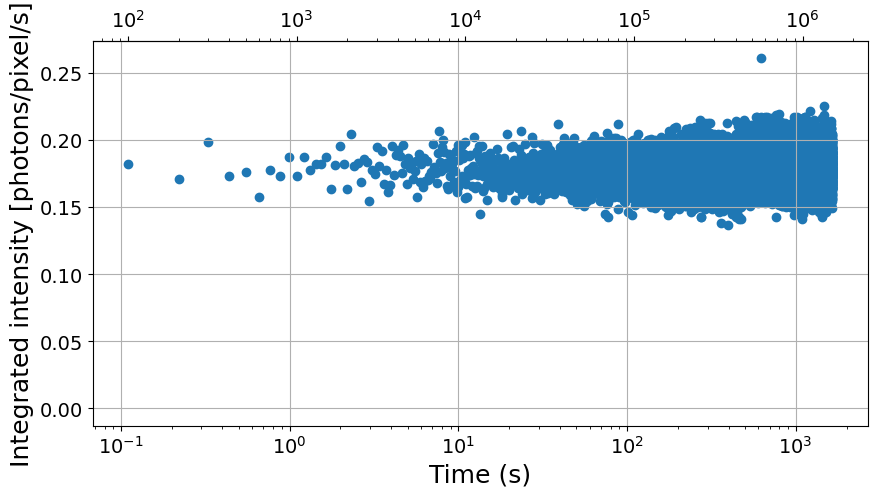

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 10
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 240024 ) ...
Loading frames ...
Done! (elapsed time = 0.68 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 1.42 s)
	 | 14002 frames X 4471016 pixels
	 | sparsity = 1.77e-03
	 | memory usage (sparse.csr_array @ float64) = 1.236 GB
Masking data ...
Done! (elapsed time = 1.96 s)
	 | 14002 frames X 1424709 pixels
	 | sparsity = 1.94e-03
	 | memory usage (sparse.csr_array @ float64) = 0.432 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 1.98 s)
	 | 14002 X 14002 squared matrix
	 | memory usage (np.array @ float64) = 1.461 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 0.11 s)

Done!

Computing G2t for bunch 2 (Nfi = 240024 , Nff = 380048 ) ...
Loading frames ...
Done! (elapsed time = 1.42 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 1.71 s)
	 | 14002 frames X 4471016 pixels
	 | sparsity = 1.76e-03
	 | memory usage (sparse.csr_array @ float64) = 1.235 G

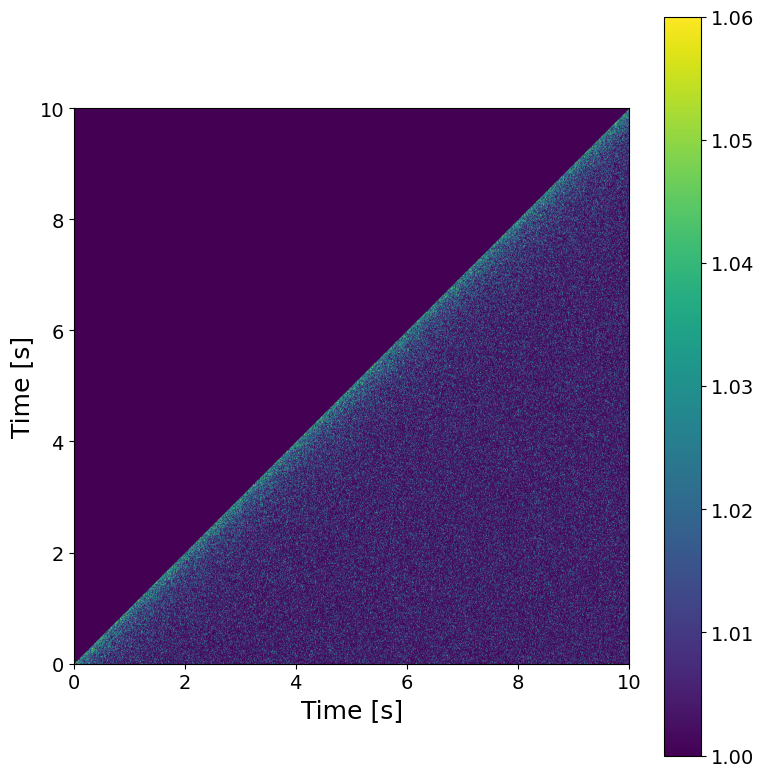

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 0.28 s)



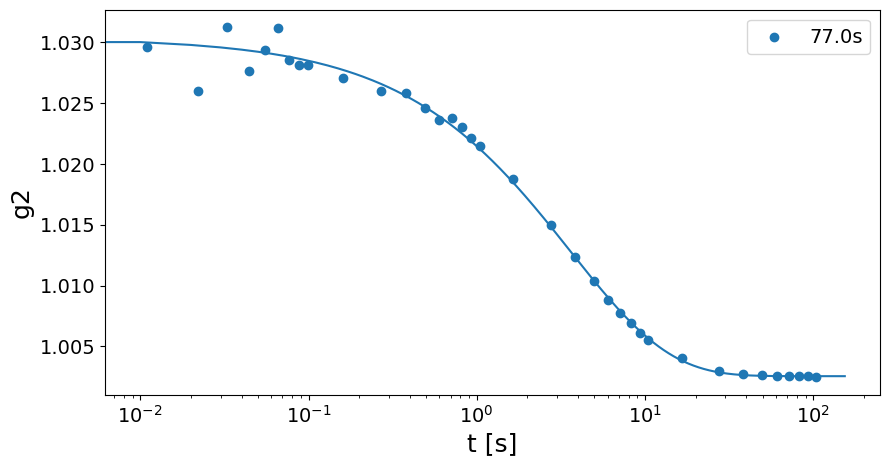

tau = 3.6196606259299324 +/- 0.17457690699488865
beta = 0.7395481140767272 +/- 0.025792743251914232
c = 0.027810997098249284 +/- 0.000769957915089052
y0 = 1.002560027609996 +/- 3.1784164972687196e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 380C Q =  0.19 Å, 50 min @ 1ms (3_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_380C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 2999568
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/600 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  12 pixels (of 4471016 => 0.0 %)
################################################################################



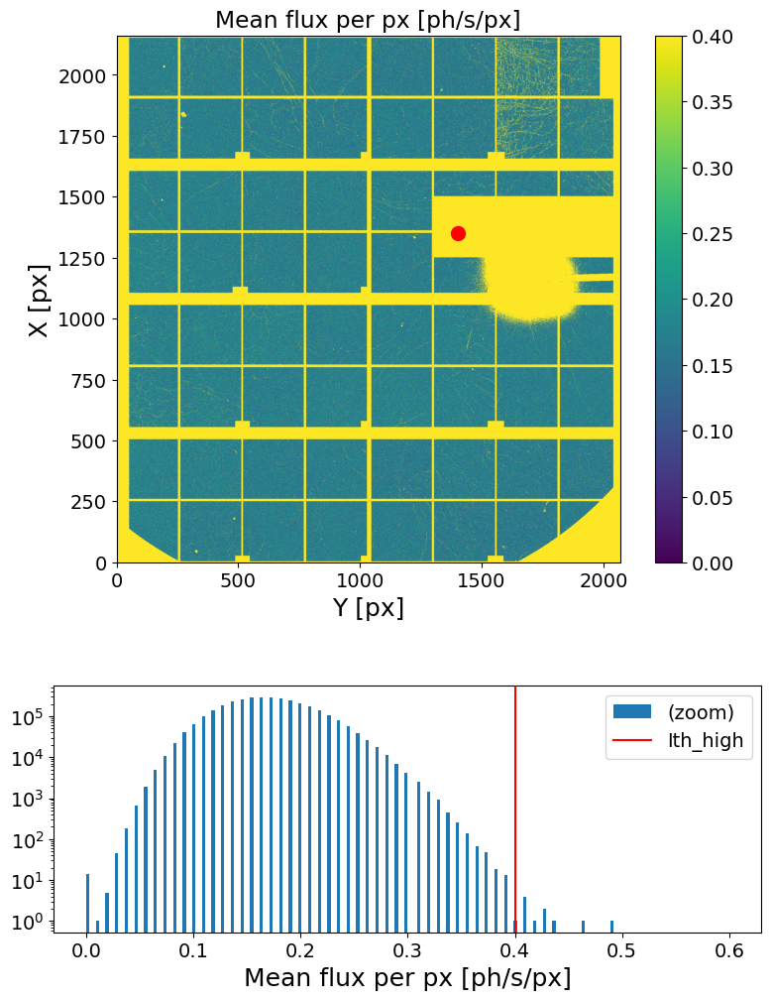

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

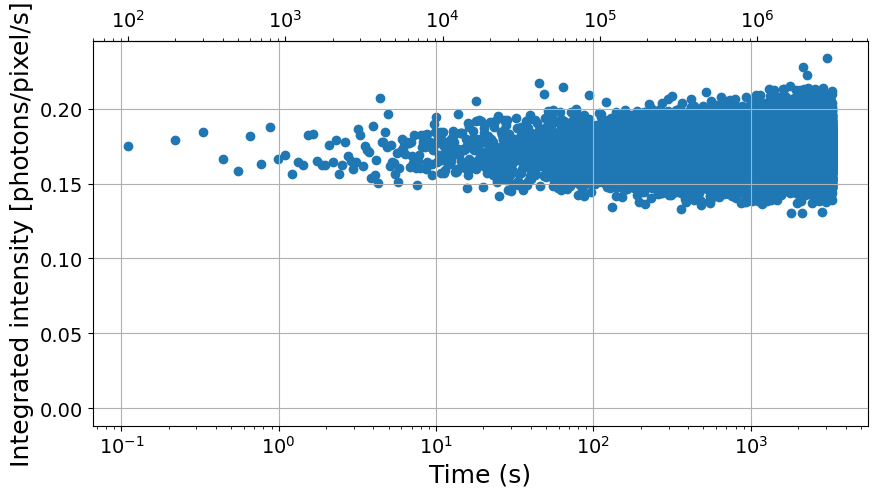

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 10
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 389956 ) ...
Loading frames ...
Done! (elapsed time = 2.15 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 4.3 s)
	 | 28995 frames X 4471016 pixels
	 | sparsity = 1.72e-03
	 | memory usage (sparse.csr_array @ float64) = 2.49 GB
Masking data ...
Done! (elapsed time = 2.04 s)
	 | 28995 frames X 1424709 pixels
	 | sparsity = 1.87e-03
	 | memory usage (sparse.csr_array @ float64) = 0.865 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 6.17 s)
	 | 28995 X 28995 squared matrix
	 | memory usage (np.array @ float64) = 6.264 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 2.39 s)

Done!

Computing G2t for bunch 2 (Nfi = 389956 , Nff = 679912 ) ...
Loading frames ...
Done! (elapsed time = 1.49 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 4.99 s)
	 | 28995 frames X 4471016 pixels
	 | sparsity = 1.72e-03
	 | memory usage (sparse.csr_array @ float64) = 2.497 GB


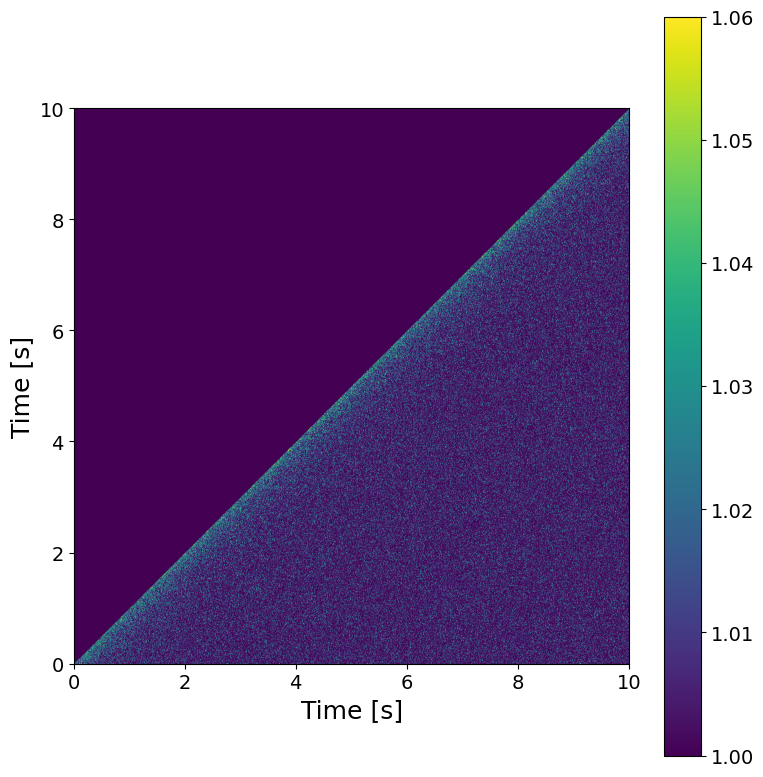

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 0.91 s)



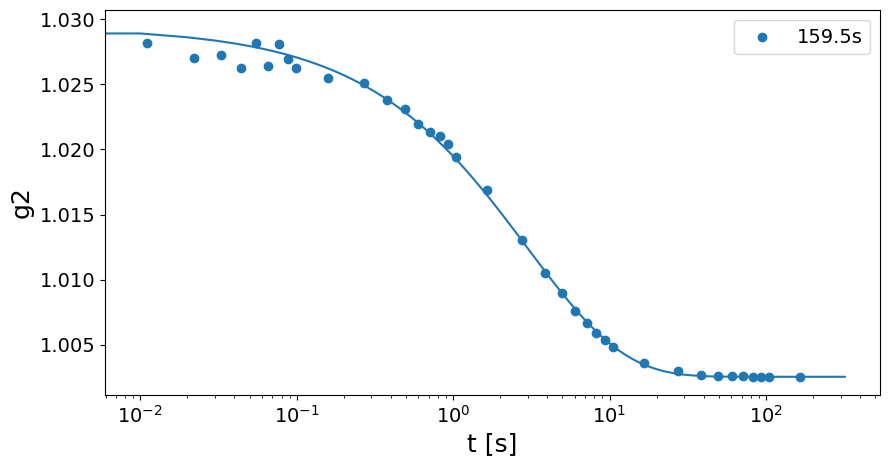

tau = 2.9959848476760125 +/- 0.18401023412770737
beta = 0.7074877226904438 +/- 0.028744781259016094
c = 0.026850062518813698 +/- 0.0009095835042782878
y0 = 1.002533045508517 +/- 2.1501534849590936e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 415C Q =  0.19 Å, 50 min @ 1ms (3_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_415C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 2999568
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/600 loop

KeyboardInterrupt: 

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  9 pixels (of 4471016 => 0.0 %)
################################################################################



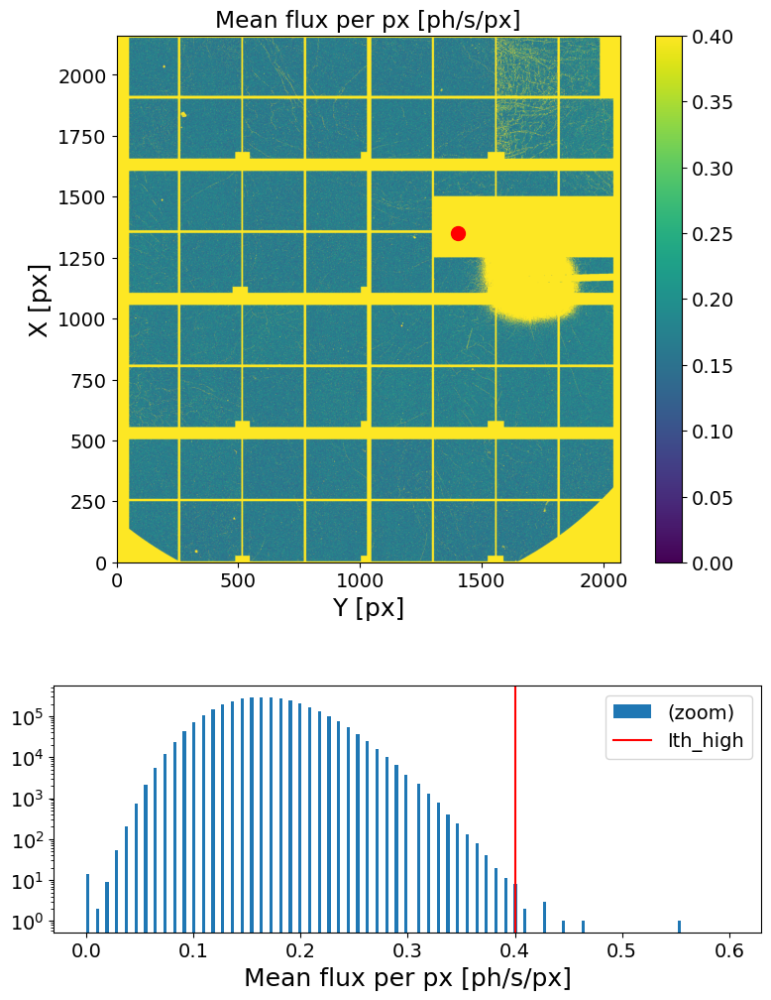

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

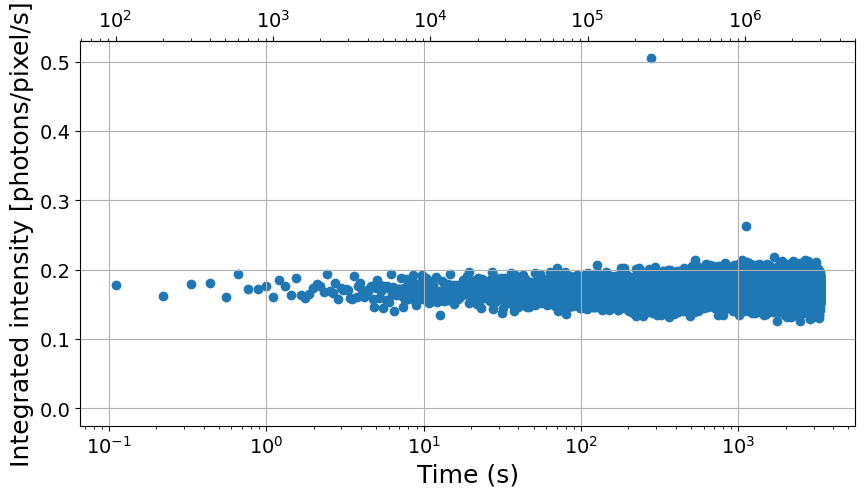

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 10
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 389956 ) ...
Loading frames ...
Done! (elapsed time = 1.38 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 4.03 s)
	 | 28995 frames X 4471016 pixels
	 | sparsity = 1.70e-03
	 | memory usage (sparse.csr_array @ float64) = 2.469 GB
Masking data ...
Done! (elapsed time = 2.39 s)
	 | 28995 frames X 1424709 pixels
	 | sparsity = 1.84e-03
	 | memory usage (sparse.csr_array @ float64) = 0.849 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 5.56 s)
	 | 28995 X 28995 squared matrix
	 | memory usage (np.array @ float64) = 6.264 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 3.27 s)

Done!

Computing G2t for bunch 2 (Nfi = 389956 , Nff = 679912 ) ...
Loading frames ...
Done! (elapsed time = 1.38 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 3.18 s)
	 | 28995 frames X 4471016 pixels
	 | sparsity = 1.75e-03
	 | memory usage (sparse.csr_array @ float64) = 2.536 G

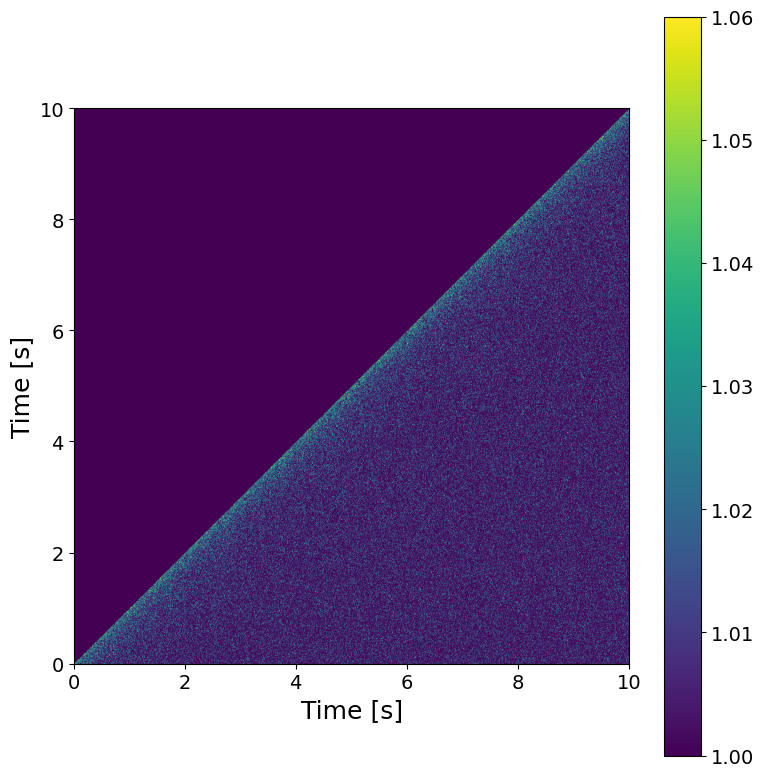

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 1.17 s)



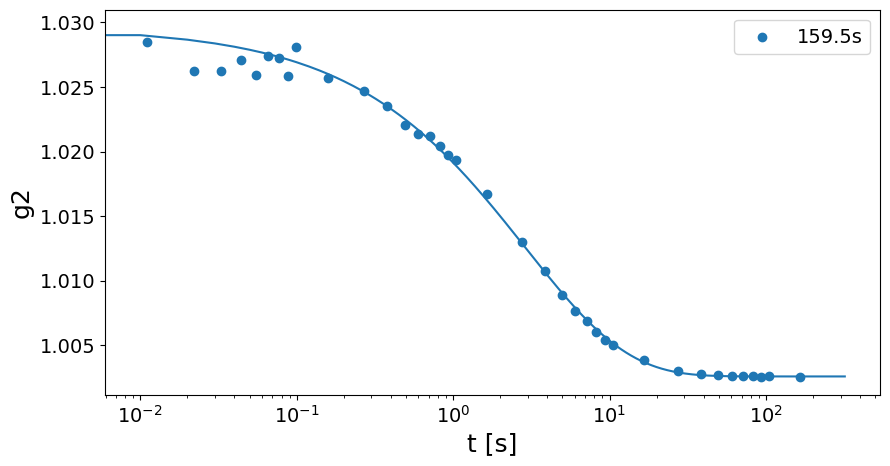

tau = 2.9089533527606357 +/- 0.19733446288134873
beta = 0.6673517850266306 +/- 0.02743842478860584
c = 0.02700873945760408 +/- 0.0009714706448069841
y0 = 1.0026022517284139 +/- 2.1864503886801458e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 450C Q =  0.19 Å, 50 min @ 1ms (3_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_450C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 2999568
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/600 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  22 pixels (of 4471016 => 0.0 %)
################################################################################



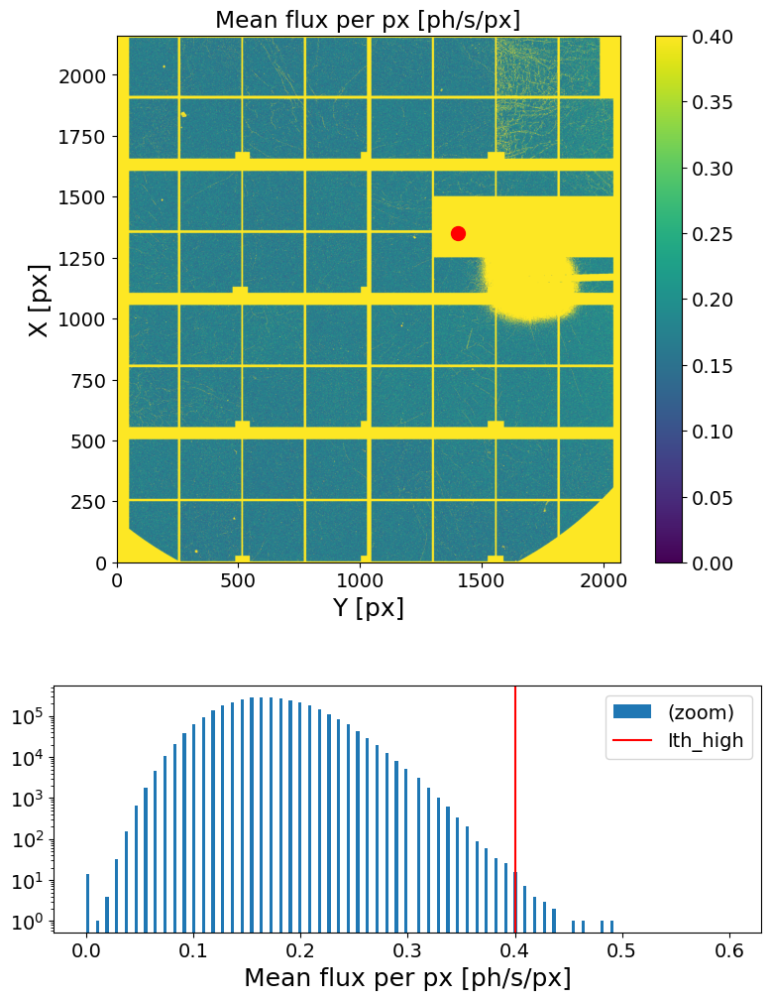

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

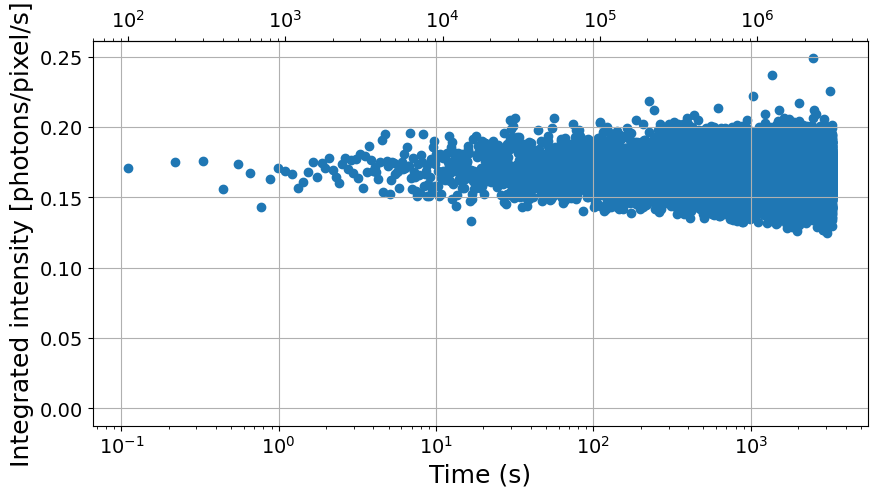

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 10
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 389956 ) ...
Loading frames ...
Done! (elapsed time = 1.55 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 2.82 s)
	 | 28995 frames X 4471016 pixels
	 | sparsity = 1.74e-03
	 | memory usage (sparse.csr_array @ float64) = 2.527 GB
Masking data ...
Done! (elapsed time = 2.32 s)
	 | 28995 frames X 1424709 pixels
	 | sparsity = 1.86e-03
	 | memory usage (sparse.csr_array @ float64) = 0.859 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 5.36 s)
	 | 28995 X 28995 squared matrix
	 | memory usage (np.array @ float64) = 6.264 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 3.38 s)

Done!

Computing G2t for bunch 2 (Nfi = 389956 , Nff = 679912 ) ...
Loading frames ...
Done! (elapsed time = 1.44 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 3.99 s)
	 | 28995 frames X 4471016 pixels
	 | sparsity = 1.74e-03
	 | memory usage (sparse.csr_array @ float64) = 2.519 G

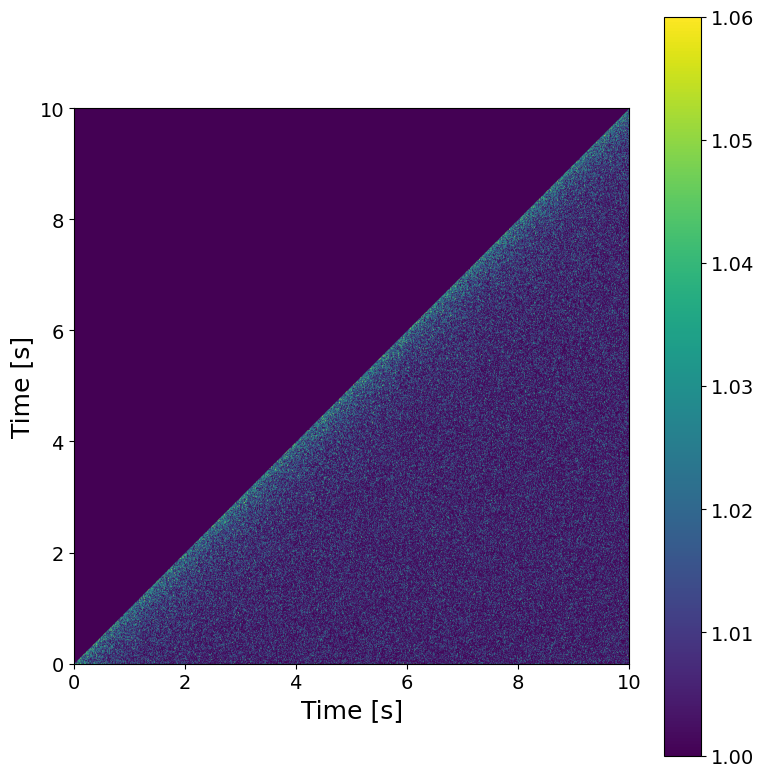

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 0.76 s)



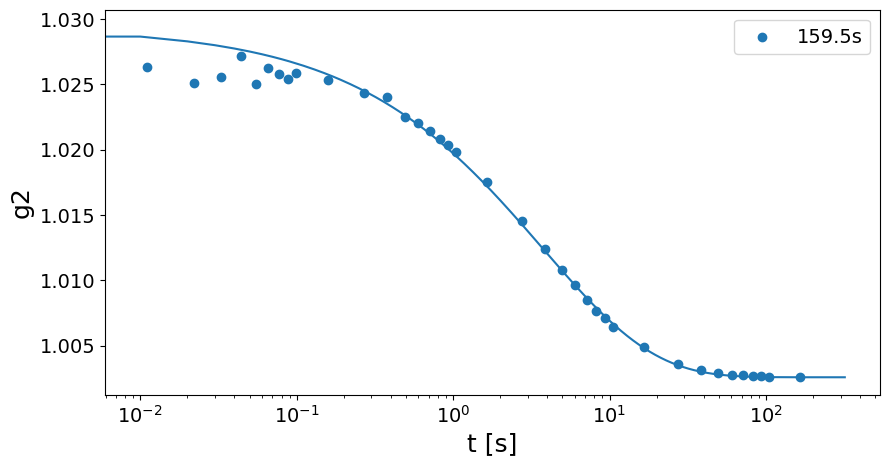

tau = 3.744163368558868 +/- 0.19059528153818153
beta = 0.6108245367439092 +/- 0.01667884180533045
c = 0.02676879412268695 +/- 0.0006825458693149623
y0 = 1.00259032452794 +/- 1.717360584383562e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 485C Q =  0.19 Å, 50 min @ 1ms (3_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_485C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, None
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 2999568
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/600 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/600 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  19 pixels (of 4471016 => 0.0 %)
################################################################################



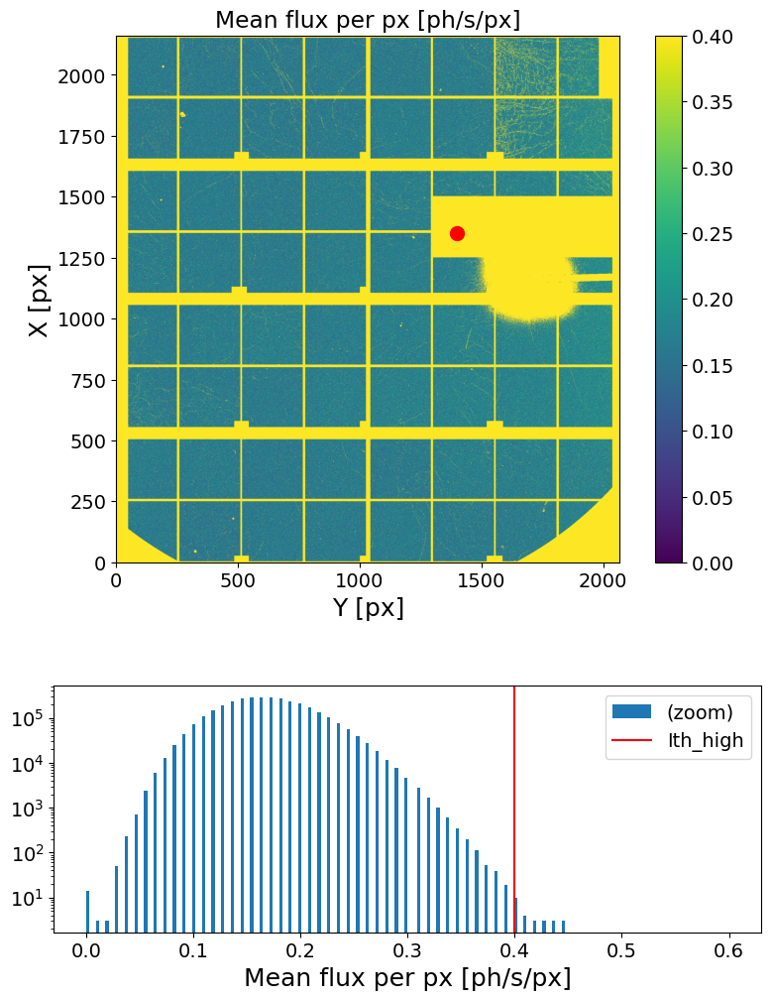

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

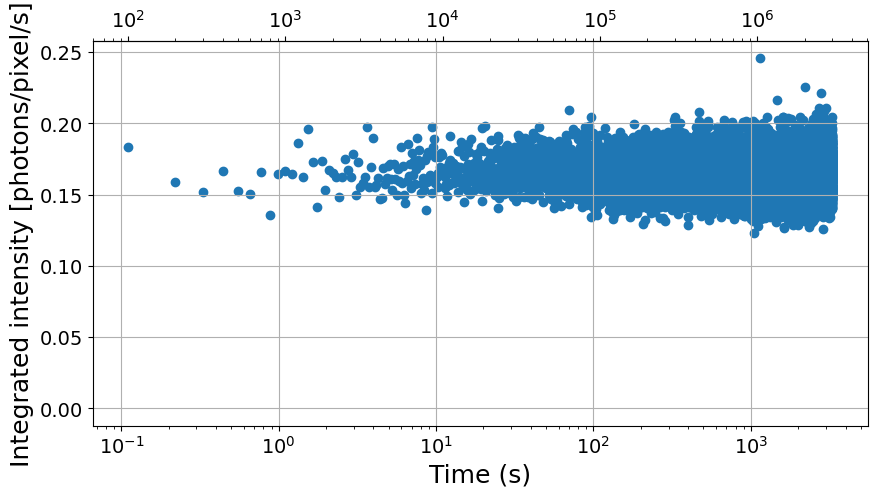

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 10
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 389956 ) ...
Loading frames ...
Done! (elapsed time = 1.55 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 4.68 s)
	 | 28995 frames X 4471016 pixels
	 | sparsity = 1.73e-03
	 | memory usage (sparse.csr_array @ float64) = 2.502 GB
Masking data ...
Done! (elapsed time = 1.96 s)
	 | 28995 frames X 1424709 pixels
	 | sparsity = 1.82e-03
	 | memory usage (sparse.csr_array @ float64) = 0.839 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 5.71 s)
	 | 28995 X 28995 squared matrix
	 | memory usage (np.array @ float64) = 6.264 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 3.73 s)

Done!

Computing G2t for bunch 2 (Nfi = 389956 , Nff = 679912 ) ...
Loading frames ...
Done! (elapsed time = 1.51 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 4.33 s)
	 | 28995 frames X 4471016 pixels
	 | sparsity = 1.73e-03
	 | memory usage (sparse.csr_array @ float64) = 2.5 GB


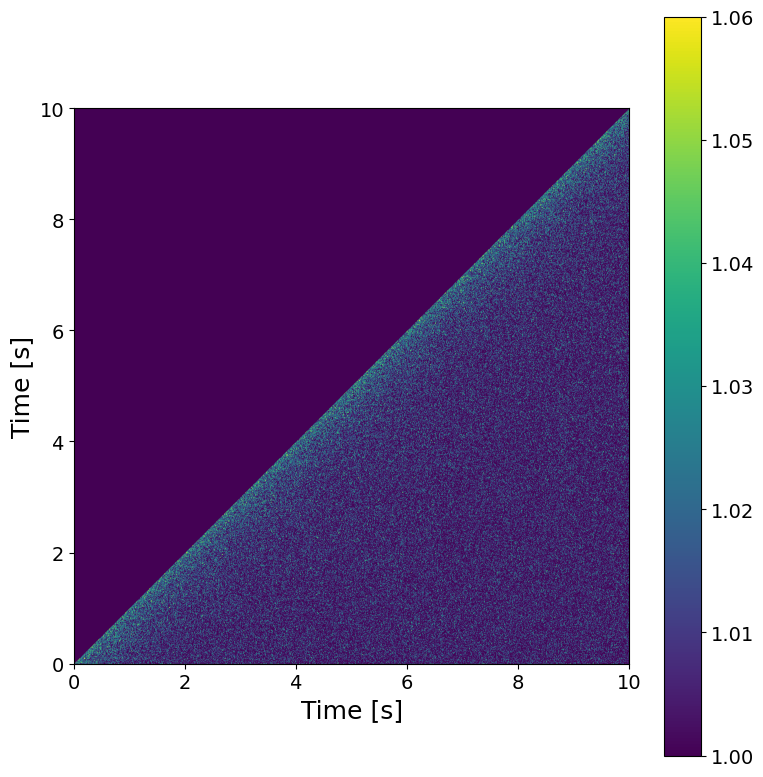

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 1.1 s)



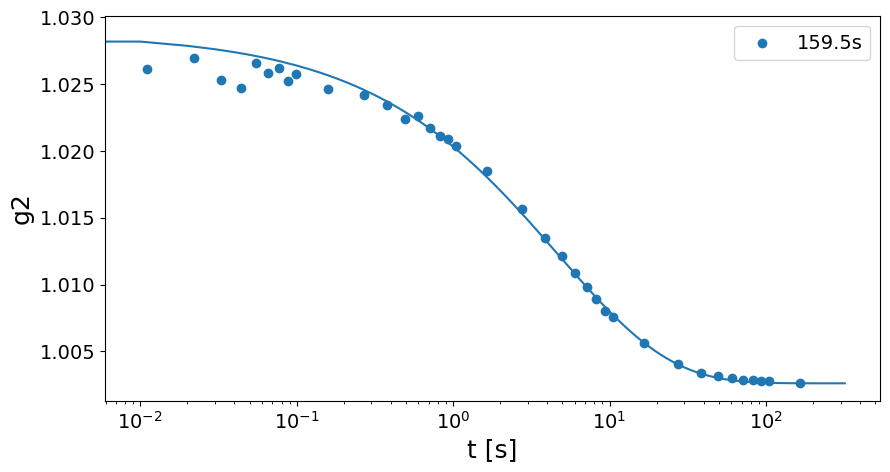

tau = 4.688976106851125 +/- 0.2644251676995958
beta = 0.6073217822628958 +/- 0.018406245942209316
c = 0.02619378588172702 +/- 0.0007392691309207616
y0 = 1.0026067527479499 +/- 2.1429765916225185e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 520C Q =  0.19 Å, 100 min @ 1ms (6_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_520C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, 3_000_000
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 6000048
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/801 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/801 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  10 pixels (of 4471016 => 0.0 %)
################################################################################



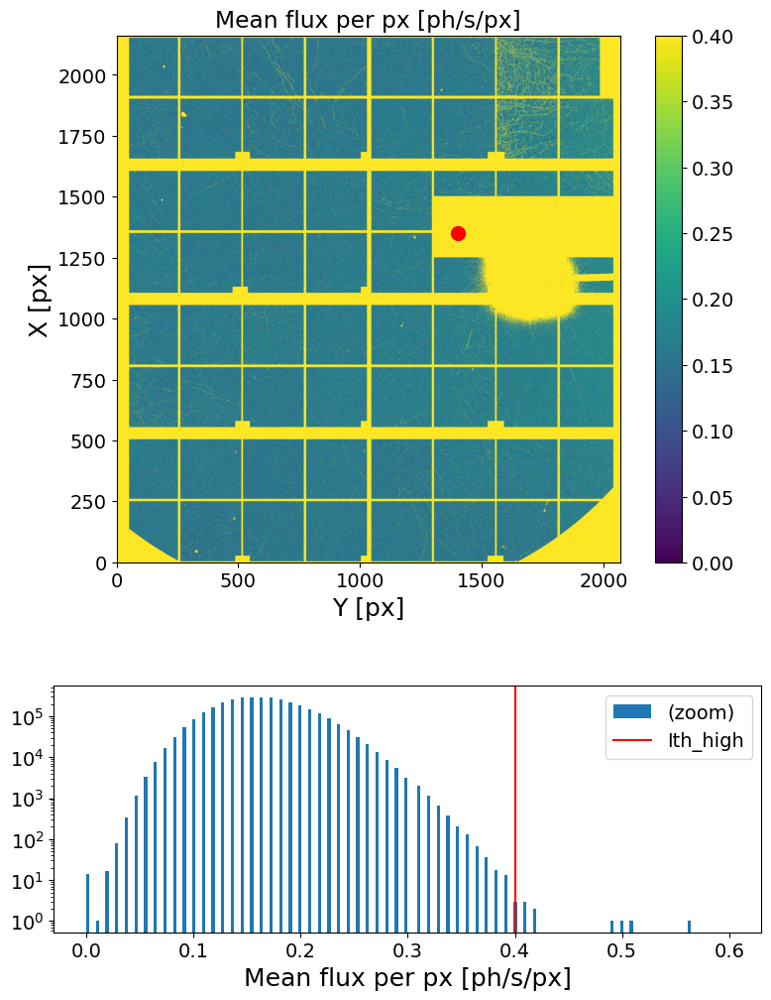

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

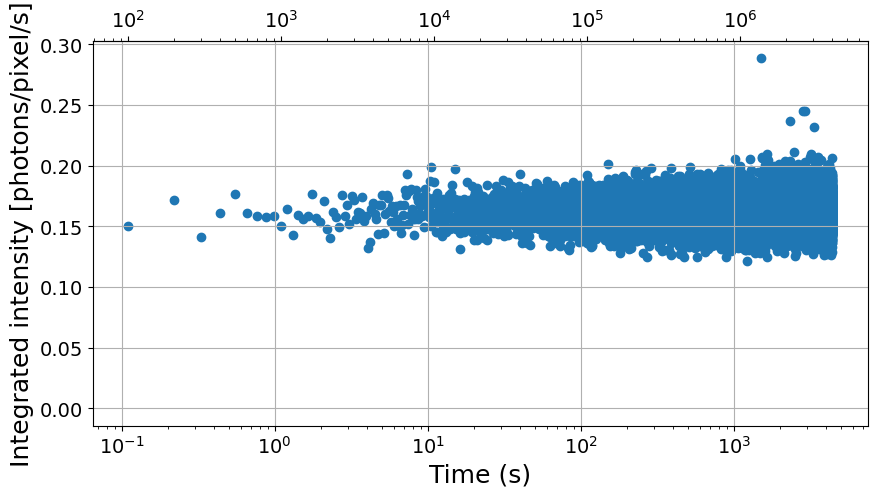

: 

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 30
Nbunch = 3
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 1400000 ) ...
Loading frames ...
Done! (elapsed time = 11.91 s)
Binning frames (Lbin = 30, using MKL library) ...
Done! (elapsed time = 23.56 s)
	 | 43333 frames X 4471016 pixels
	 | sparsity = 5.02e-03
	 | memory usage (sparse.csr_array @ float64) = 10.872 GB
Masking data ...
Done! (elapsed time = 9.48 s)
	 | 43333 frames X 1424709 pixels
	 | sparsity = 5.29e-03
	 | memory usage (sparse.csr_array @ float64) = 3.649 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 23.83 s)
	 | 43333 X 43333 squared matrix
	 | memory usage (np.array @ float64) = 13.99 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 6.13 s)

Done!

Computing G2t for bunch 2 (Nfi = 1400000 , Nff = 2700000 ) ...
Loading frames ...
Done! (elapsed time = 24.74 s)
Binning frames (Lbin = 30, using MKL library) ...


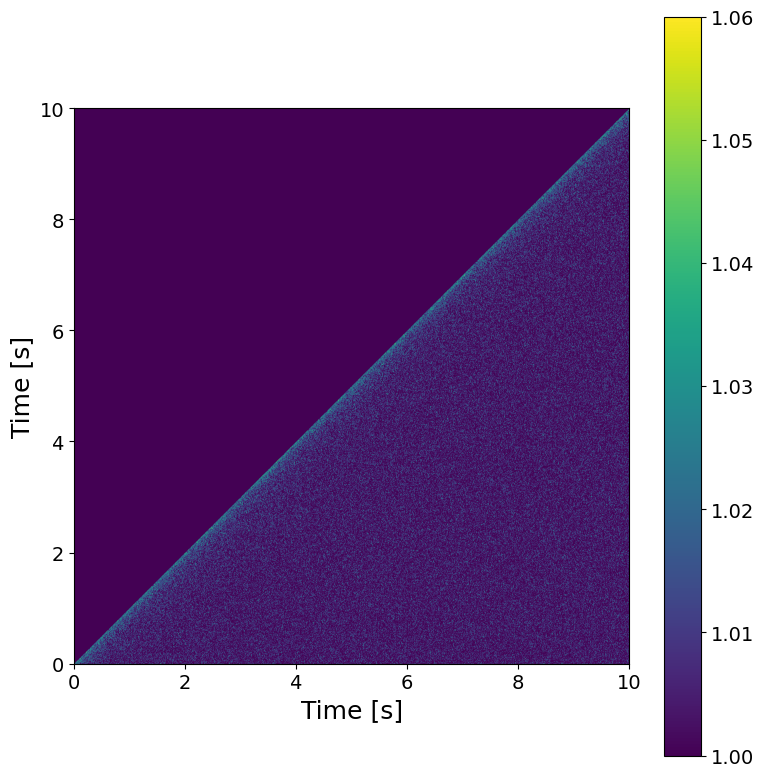

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])    


Computing g2...
Done! (elapsed time = 0.48 s)



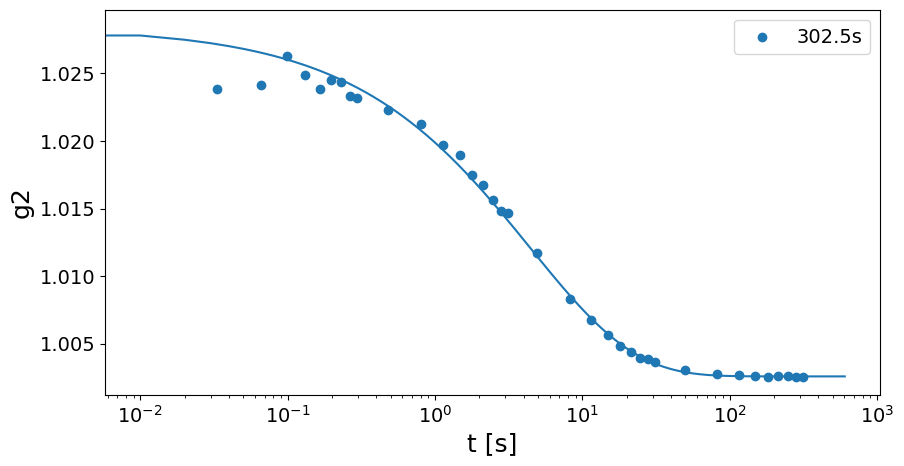

tau = 4.438074700857541 +/- 0.37243978248717863
beta = 0.614161264911055 +/- 0.027430254859874017
c = 0.025840914956010274 +/- 0.0010881745203525793
y0 = 1.0025719618808753 +/- 2.047764521909123e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 555C Q =  0.19 Å, 100 min @ 1ms (6_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
mu = 131.616
I6 = (7.686+7)/2
I3 = (5.219+4.388)/2
I7 = 5.12
Ia6 = 11.276
d6 = -np.log(I6/Ia6)*mu
d3 = -np.log(I3/Ia6)*mu
d7 = -np.log(I7/Ia6)*mu
d7

np.float64(103.91374521492638)

In [ ]:
#######################################
sample_name = 'GeO2_3_555C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, 3_000_000
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 6000048
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/201 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/201 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  18 pixels (of 4471016 => 0.0 %)
################################################################################



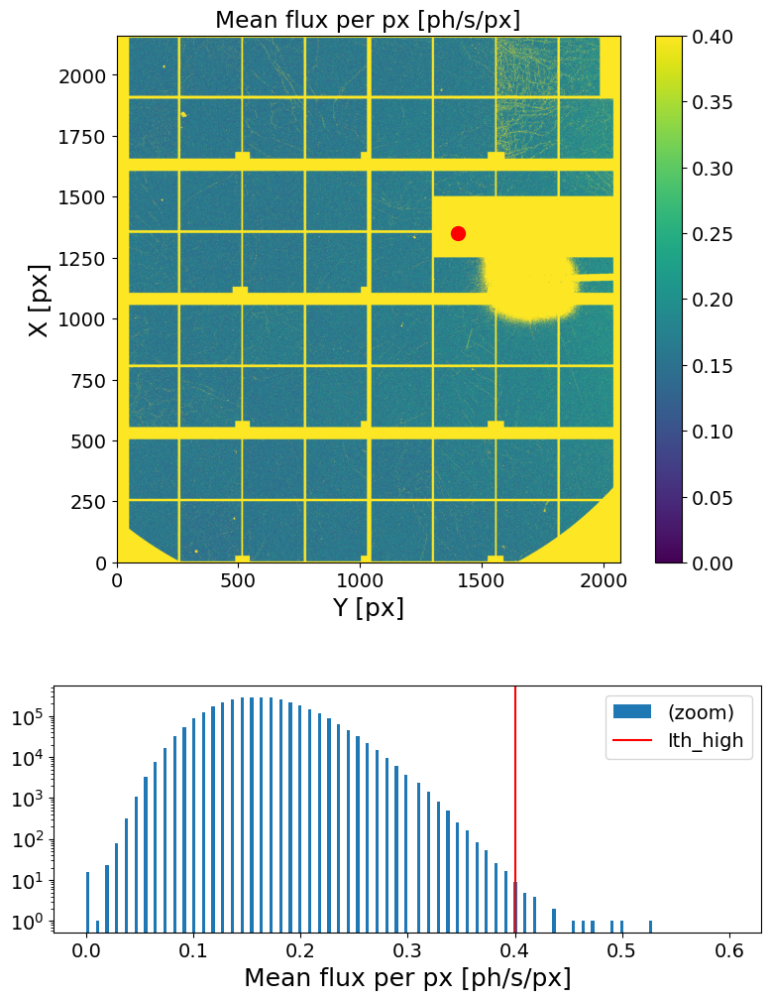

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

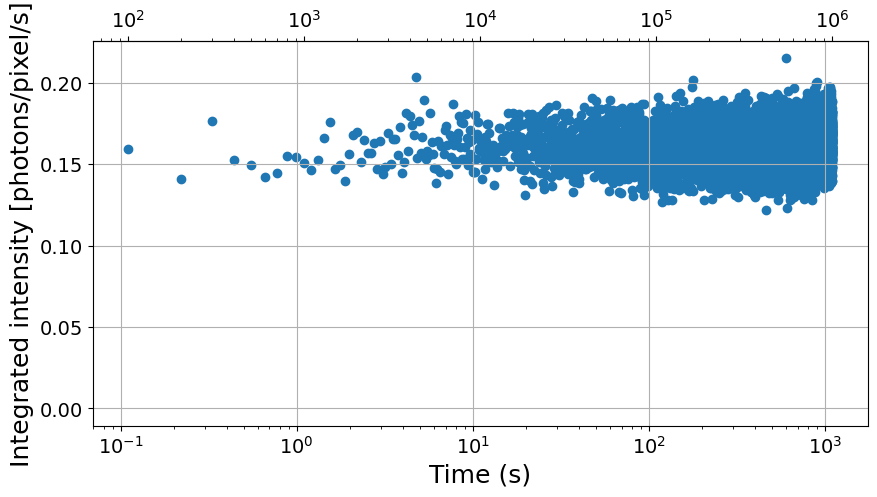

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 30
Nbunch = 3
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 400000 ) ...
Loading frames ...
Done! (elapsed time = 3.34 s)
Binning frames (Lbin = 30, using MKL library) ...
Done! (elapsed time = 4.54 s)
	 | 10000 frames X 4471016 pixels
	 | sparsity = 5.04e-03
	 | memory usage (sparse.csr_array @ float64) = 2.517 GB
Masking data ...
Done! (elapsed time = 4.36 s)
	 | 10000 frames X 1424709 pixels
	 | sparsity = 5.27e-03
	 | memory usage (sparse.csr_array @ float64) = 0.839 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 4.81 s)
	 | 10000 X 10000 squared matrix
	 | memory usage (np.array @ float64) = 0.745 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 0.29 s)

Done!

Computing G2t for bunch 2 (Nfi = 400000 , Nff = 700000 ) ...
Loading frames ...
Done! (elapsed time = 4.81 s)
Binning frames (Lbin = 30, using MKL library) ...
Done! (elapsed time = 3.93 s)
	 | 10000 frames X 4471016 pixels
	 | sparsity = 5.03e-03
	 | memory usage (sparse.csr_array @ float64) = 2.512 G

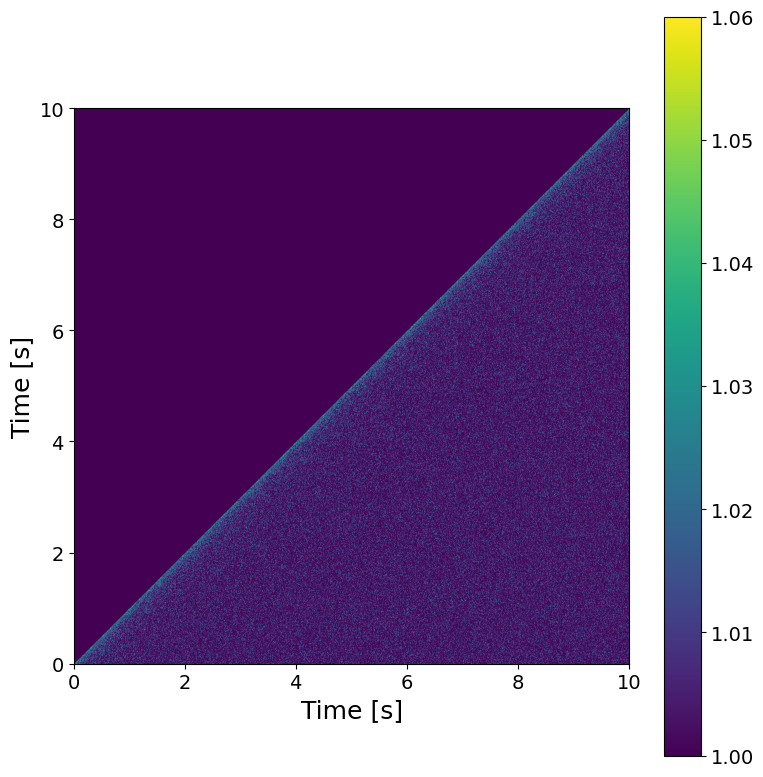

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])

if Nbunch == 1:
    np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It, t=t, g2=g2, t_mt=t_mt, g2_mt=g2_mt)


Computing g2...
Done! (elapsed time = 0.15 s)



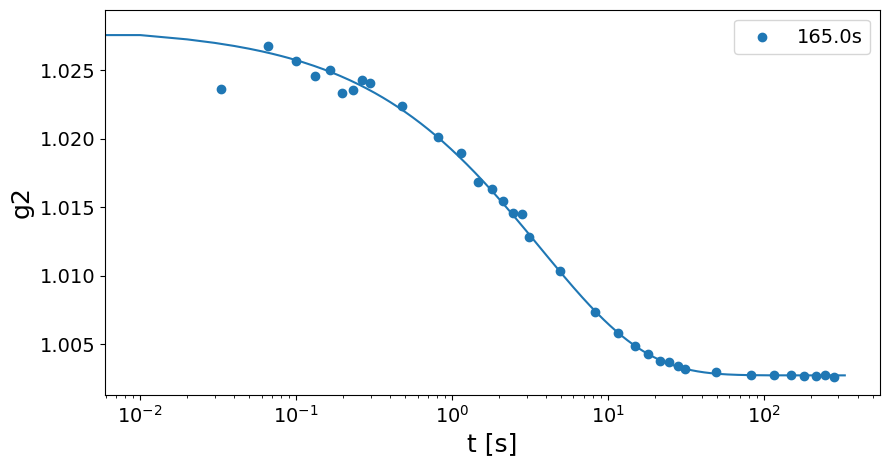

tau = 3.6538616874681837 +/- 0.36804517960992394
beta = 0.6424173396024987 +/- 0.037087562026355936
c = 0.025441280600184156 +/- 0.0013303631846157506
y0 = 1.0027030860750135 +/- 3.211766976915047e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 590C Q =  0.19 Å, 100 min @ 1ms (6_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_590C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, 3_000_000
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 6000048
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/601 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/601 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  5 pixels (of 4471016 => 0.0 %)
################################################################################



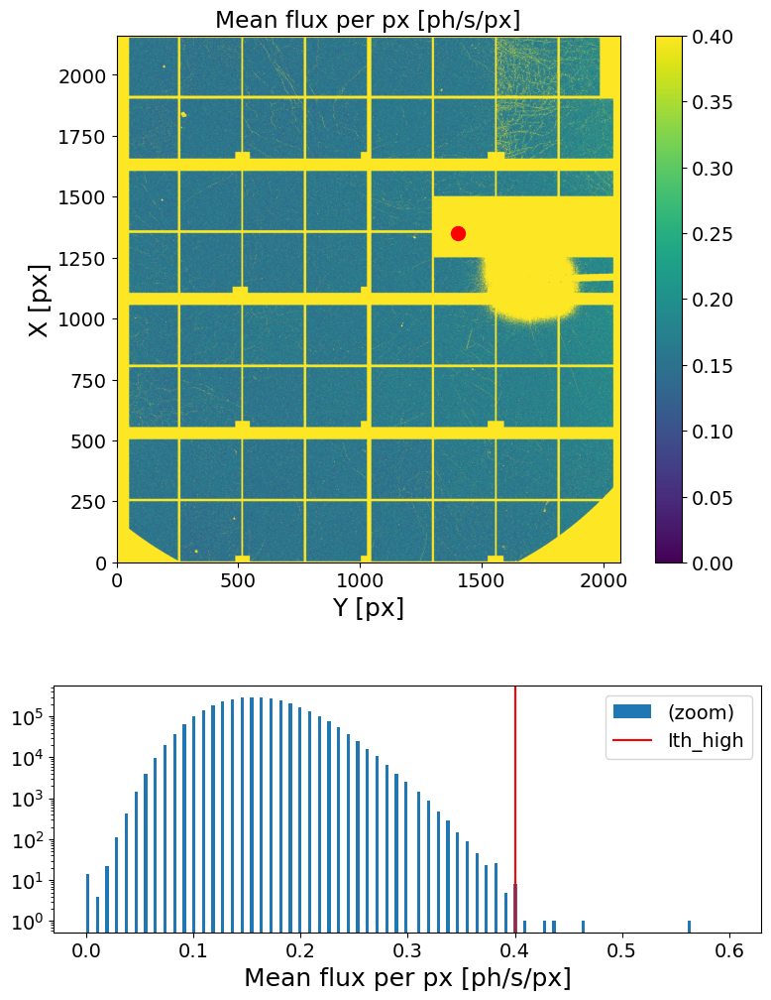

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=100_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

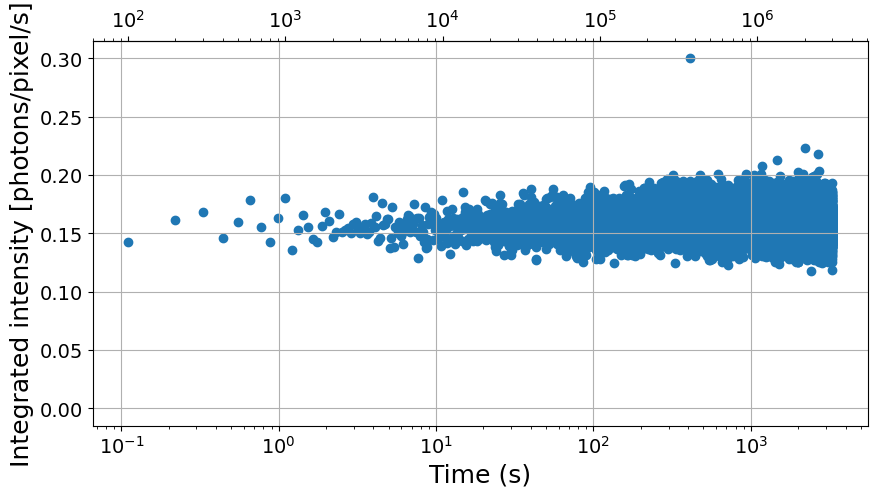

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 100_000
Nff = None
Lbin = 10
Nbunch = 20
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 100000 , Nff = 245000 ) ...
Loading frames ...
Done! (elapsed time = 1.16 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 0.79 s)
	 | 14500 frames X 4471016 pixels
	 | sparsity = 1.67e-03
	 | memory usage (sparse.csr_array @ float64) = 1.209 GB
Masking data ...
Done! (elapsed time = 2.45 s)
	 | 14500 frames X 1424709 pixels
	 | sparsity = 1.75e-03
	 | memory usage (sparse.csr_array @ float64) = 0.404 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 1.69 s)
	 | 14500 X 14500 squared matrix
	 | memory usage (np.array @ float64) = 1.566 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 0.09 s)

Done!

Computing G2t for bunch 2 (Nfi = 245000 , Nff = 390000 ) ...
Loading frames ...
Done! (elapsed time = 1.0 s)
Binning frames (Lbin = 10, using MKL library) ...
Done! (elapsed time = 1.56 s)
	 | 14500 frames X 4471016 pixels
	 | sparsity = 1.70e-03
	 | memory usage (sparse.csr_array @ float64) = 1.234 GB

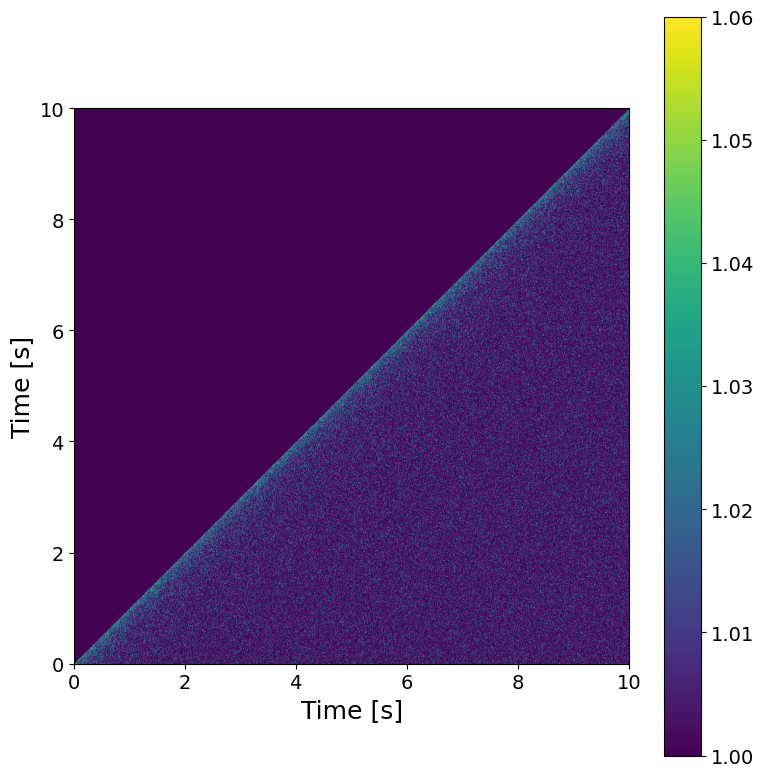

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])

if Nbunch == 1:
    np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It, t=t, g2=g2, t_mt=t_mt, g2_mt=g2_mt)


Computing g2...
Done! (elapsed time = 0.33 s)



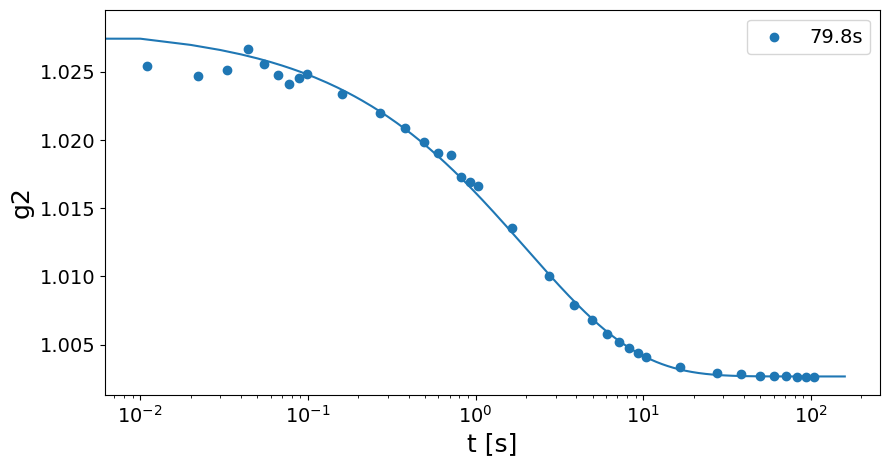

tau = 1.9898961875124752 +/- 0.1386431343022746
beta = 0.6439941879616325 +/- 0.02596554947730276
c = 0.025564580244255456 +/- 0.0009256873601369966
y0 = 1.0026731182436175 +/- 2.43431231430198e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS scan (T = 625C Q =  0.19 Å, 100 min @ 1ms (6_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_625C'
Ndataset = 1
Nscan = 4
Nfi, Nff =  None, 1_800_000
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan)
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('Ei =', Ei)
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

e4m_data = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )
#e4m_data = ID10.load_dense_e4m_new(raw_folder, sample_name, Ndataset, Nscan, Nfi, Nff,  n_jobs=1, )

e4m_data = COSMIC.fast_gamma_filter(e4m_data, Imaxth_high=5)

#############################
command = mtimescan 0.001 1 8999616
Ei = 9.699998837562536
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/361 loop

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  3 pixels (of 4471016 => 0.0 %)
################################################################################



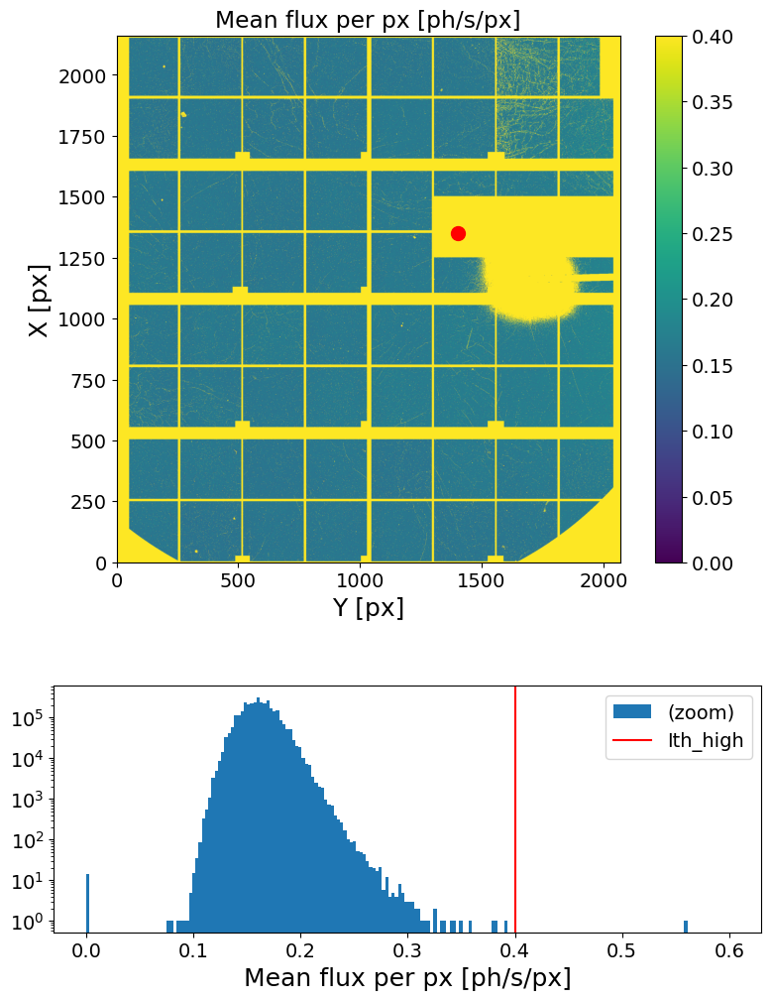

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data, itime, Ith_high= .4, Nff=1_000_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = XPCS.get_It(e4m_data, itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It)

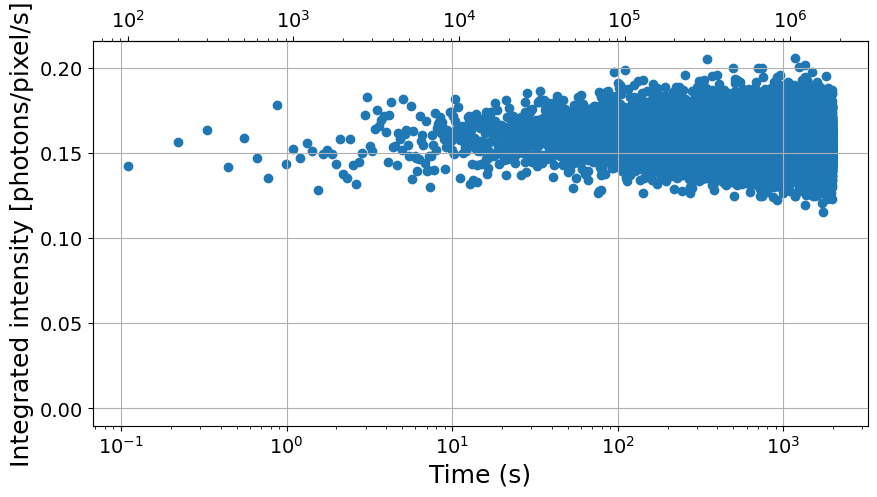

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(t_It, It, label='It')

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.xscale('log')
#plt.xlim(1e-2, 1)
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))
plt.grid()

### Correlation

In [ ]:
###################
Nfi = 1
Nff = None
Lbin = 5
Nbunch = 20
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = XPCS.get_G2t_bybunch(e4m_data, mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)

Computing G2t for bunch 1 (Nfi = 1 , Nff = 90000 ) ...
Loading frames ...
Done! (elapsed time = 0.73 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 1.12 s)
	 | 17999 frames X 4471016 pixels
	 | sparsity = 8.30e-04
	 | memory usage (sparse.csr_array @ float64) = 0.747 GB
Masking data ...
Done! (elapsed time = 1.79 s)
	 | 17999 frames X 1424709 pixels
	 | sparsity = 8.77e-04
	 | memory usage (sparse.csr_array @ float64) = 0.252 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 1.01 s)
	 | 17999 X 17999 squared matrix
	 | memory usage (np.array @ float64) = 2.414 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 0.12 s)

Done!

Computing G2t for bunch 2 (Nfi = 90000 , Nff = 179999 ) ...
Loading frames ...
Done! (elapsed time = 0.65 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 0.89 s)
	 | 17999 frames X 4471016 pixels
	 | sparsity = 8.29e-04
	 | memory usage (sparse.csr_array @ float64) = 0.746 GB
Masking

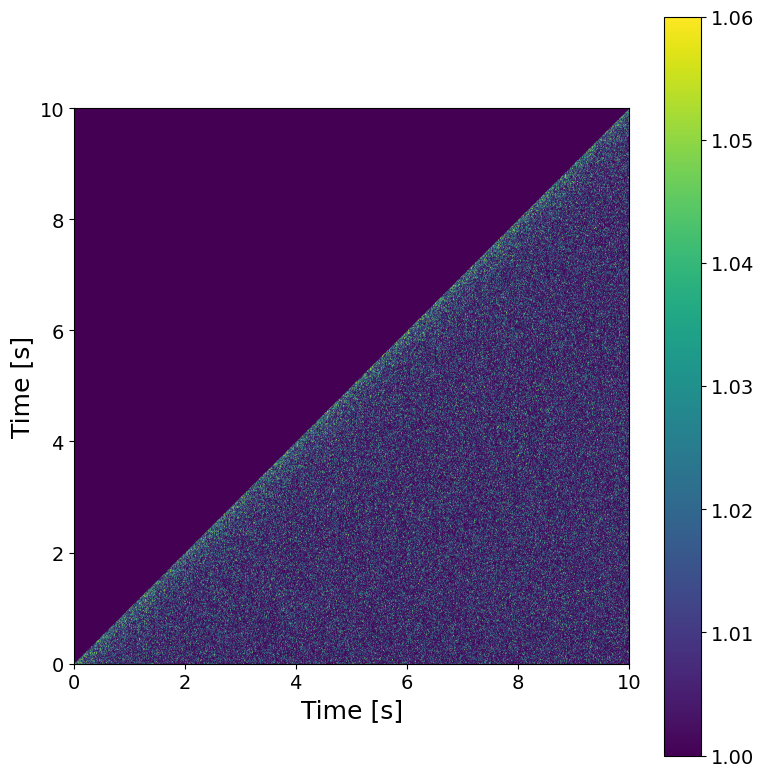

In [ ]:
############################
t1, t2 = 0, 10
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
################
Nbunch = 1
################

NfXbunch = int(G2t.shape[0]/Nbunch)
t, g2, t_mt, g2_mt = {}, {}, {}, {}
for n in range(Nbunch):
    t_bunch = round(itime*Lbin*NfXbunch*(n+1/2),1)

    t[t_bunch], g2[t_bunch] = XPCS.get_g2(itime*Lbin, np.array(G2t[NfXbunch*n:NfXbunch*(n+1), NfXbunch*n:NfXbunch*(n+1)]), cython=False)
    t_mt[t_bunch], g2_mt[t_bunch] = XPCS.get_g2_mt(itime*Lbin, g2[t_bunch])

if Nbunch == 1:
    np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4), t_It=t_It, It=It, t=t, g2=g2, t_mt=t_mt, g2_mt=g2_mt)


Computing g2...
Done! (elapsed time = 0.87 s)



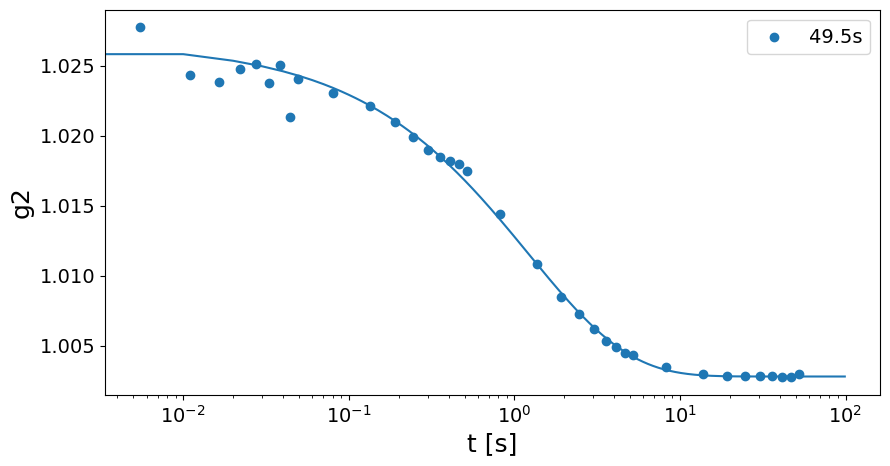

tau = 1.2199590076826736 +/- 0.1258532888691753
beta = 0.7155804216020656 +/- 0.04987071348435895
c = 0.02379247762976196 +/- 0.001367600842351086
y0 = 1.0027932240300965 +/- 3.7720738207583486e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'
for k in g2.keys():
    #plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
    plt.scatter(t_mt[k], g2_mt[k], label=str(k)+'s')

    popt, pcov = curve_fit(decorelation_f, t[k][(t1_fit<t[k])*(t[k]<t2_fit)], g2[k][(t1_fit<t[k])*(t[k]<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
    fit_out.loc[k] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]
    
    x = np.arange(np.min(t[k]), np.max(t[k]), 1e-2)
    y = decorelation_f(x, *popt)
    plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan).zfill(4)+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

if Nbunch == 1:
    print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
    print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
    print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
    print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')
else:
    plt.figure(figsize=(10,5))
    plt.title('tau')
    plt.errorbar(fit_out.index, fit_out.tau,  yerr=fit_out.dtau, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('tau [s]')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('beta')
    plt.errorbar(fit_out.index, fit_out.beta,  yerr=fit_out.dbeta, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('beta')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('c')
    plt.errorbar(fit_out.index, fit_out.c,  yerr=fit_out.dc, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('c')
    plt.xlim(0)
    plt.show()

    plt.figure(figsize=(10,5))
    plt.title('y0')
    plt.errorbar(fit_out.index, fit_out.y0,  yerr=fit_out.dy0, fmt='o')
    plt.xlabel('t [s]')
    plt.ylabel('y0')
    plt.show()  

## XPCS mesh (T = 660C Q =  0.19 Å, 100 min @ 1ms (6_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_660C'
Ndataset = 1
Nscan = range(4, 5+1)
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan[0])
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

#############################
command = mtimescan 0.001 1 2400384
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################



In [ ]:
e4m_data = {}
for s in Nscan:
    e4m_data[s] = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, s)
    e4m_data[s] = COSMIC.fast_gamma_filter(e4m_data[s], Imaxth_high=5)

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00012.h5 (13/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00013.h5 (14/481 loops)
	 -> loading file eiger4m_v2_spa

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  3 pixels (of 4471016 => 0.0 %)
################################################################################



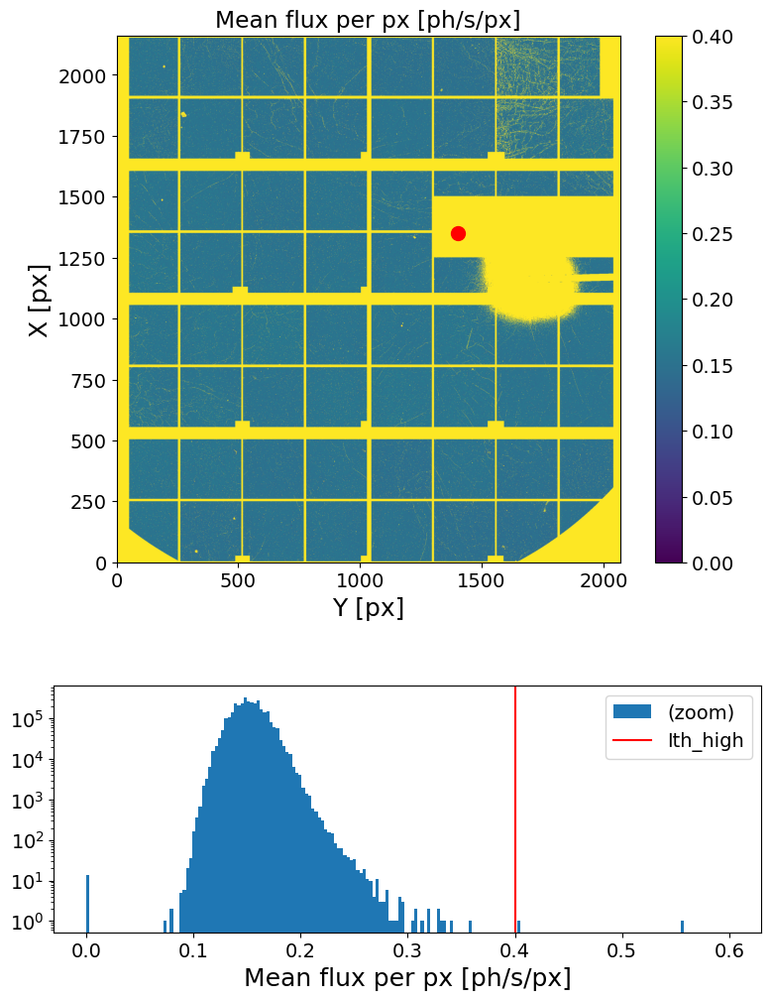

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data[4], itime, Ith_high= .4, Nff=1_000_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = {}, {}
for s in Nscan:
    t_It[s], It[s] = XPCS.get_It(e4m_data[s], itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
    np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(s).zfill(4), t_It=t_It[s], It=It[s])

100%|██████████| 2/2 [00:00<00:00, 127.00it/s]


<SecondaryAxis: >

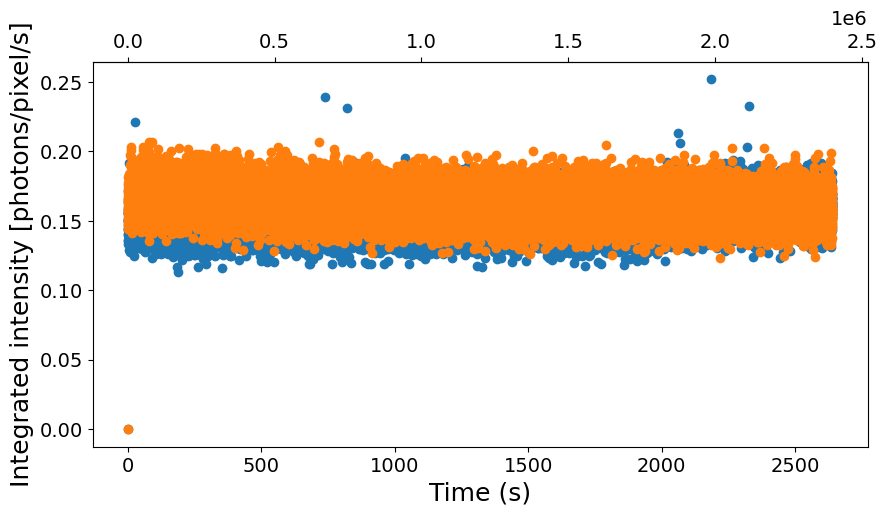

In [ ]:
plt.figure(figsize=(10,5))
for s in tqdm(Nscan):
    plt.scatter(t_It[s], It[s])

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))


### Correlation

In [ ]:
###################
Nfi = 1
Nff = None
Lbin = 5
Nbunch = 20
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = np.zeros((e4m_data[Nscan[0]].shape[0]//Nbunch//Lbin, e4m_data[Nscan[0]].shape[0]//Nbunch//Lbin))
for s in tqdm(Nscan): G2t += XPCS.get_G2t_bybunch(e4m_data[s], mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)
G2t /= len(Nscan)

  0%|          | 0/2 [00:00<?, ?it/s]

Computing G2t for bunch 1 (Nfi = 1 , Nff = 120020 ) ...
Loading frames ...
Done! (elapsed time = 0.83 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 2.02 s)
	 | 24003 frames X 4471016 pixels
	 | sparsity = 7.77e-04
	 | memory usage (sparse.csr_array @ float64) = 0.932 GB
Masking data ...
Done! (elapsed time = 2.48 s)
	 | 24003 frames X 1424709 pixels
	 | sparsity = 8.41e-04
	 | memory usage (sparse.csr_array @ float64) = 0.321 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 3.19 s)
	 | 24003 X 24003 squared matrix
	 | memory usage (np.array @ float64) = 4.293 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 1.61 s)

Done!

Computing G2t for bunch 2 (Nfi = 120020 , Nff = 240039 ) ...
Loading frames ...
Done! (elapsed time = 0.58 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 1.75 s)
	 | 24003 frames X 4471016 pixels
	 | sparsity = 7.71e-04
	 | memory usage (sparse.csr_array @ float64) = 0.925 GB
Maski

 50%|█████     | 1/2 [03:32<03:32, 212.03s/it]

Computing G2t for bunch 1 (Nfi = 1 , Nff = 120020 ) ...
Loading frames ...
Done! (elapsed time = 0.6 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 1.57 s)
	 | 24003 frames X 4471016 pixels
	 | sparsity = 9.13e-04
	 | memory usage (sparse.csr_array @ float64) = 1.095 GB
Masking data ...
Done! (elapsed time = 1.21 s)
	 | 24003 frames X 1424709 pixels
	 | sparsity = 9.32e-04
	 | memory usage (sparse.csr_array @ float64) = 0.356 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 2.97 s)
	 | 24003 X 24003 squared matrix
	 | memory usage (np.array @ float64) = 4.293 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 2.0 s)

Done!

Computing G2t for bunch 2 (Nfi = 120020 , Nff = 240039 ) ...
Loading frames ...
Done! (elapsed time = 0.65 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 1.95 s)
	 | 24003 frames X 4471016 pixels
	 | sparsity = 8.99e-04
	 | memory usage (sparse.csr_array @ float64) = 1.078 GB
Masking

100%|██████████| 2/2 [07:00<00:00, 210.42s/it]


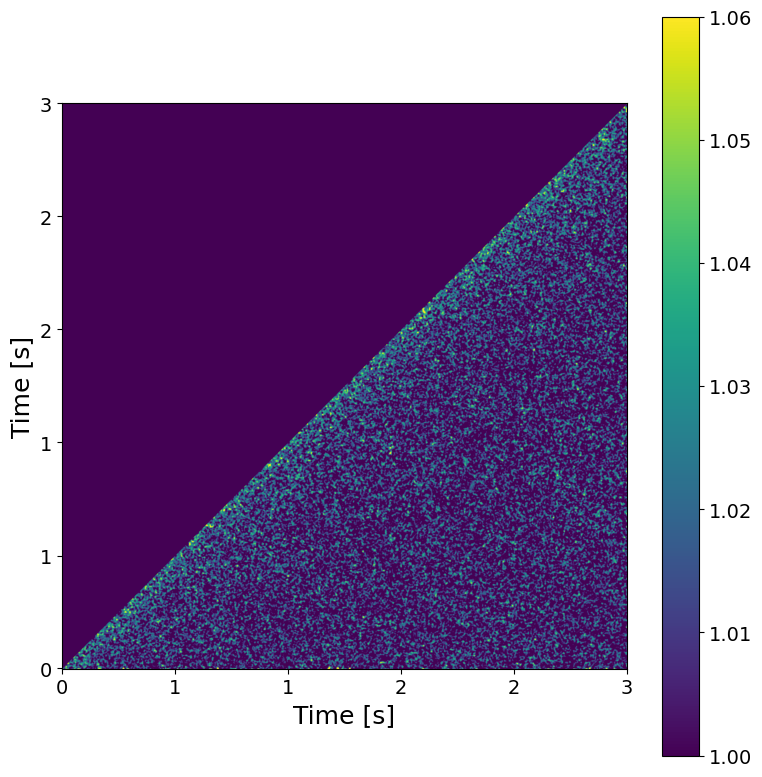

In [ ]:
############################
t1, t2 = 0, 3
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
t, g2 = XPCS.get_g2(itime*Lbin, np.array(G2t), cython=False)
t_mt, g2_mt = XPCS.get_g2_mt(itime*Lbin, g2)

np.savez(g2_folder+'g2_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan[0])+'_'+str(Nscan[-1]), t=t, g2=g2, t_mt=t_mt, g2_mt=g2_mt)

Computing g2...
Done! (elapsed time = 0.69 s)



/tmp/ipykernel_265930/788206347.py:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


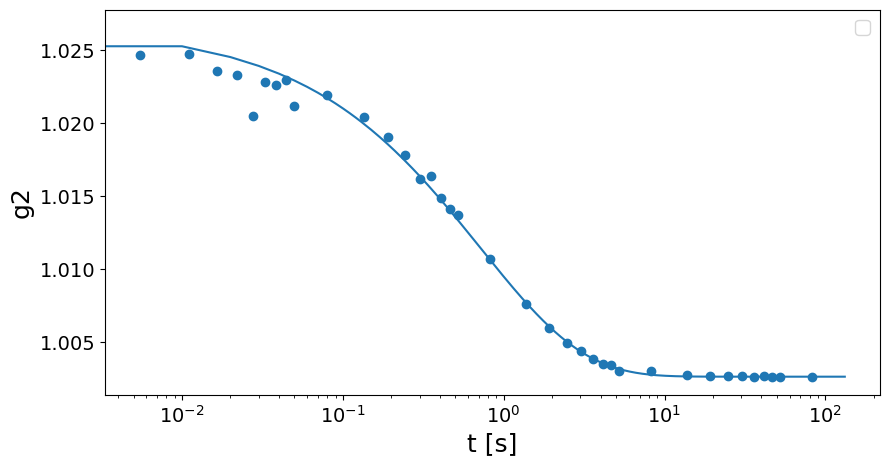

tau = 0.718547534937215 +/- 0.07712655656866091
beta = 0.6754168170064132 +/- 0.04430827201738219
c = 0.023957933088569385 +/- 0.0013736958694284276
y0 = 1.0026269856053898 +/- 2.314968029691736e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'

#plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
plt.scatter(t_mt, g2_mt)

popt, pcov = curve_fit(decorelation_f, t[(t1_fit<t)*(t<t2_fit)], g2[(t1_fit<t)*(t<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
fit_out.loc[0] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]

x = np.arange(np.min(t), np.max(t), 1e-2)
y = decorelation_f(x, *popt)
plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan[0])+'-'+str(Nscan[-1])+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')

## XPCS mesh (T = 690C Q =  0.19 Å, 100 min @ 1ms (6_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [ ]:
#######################################
sample_name = 'GeO2_3_695C'
Ndataset = 1
Nscan = range(4, 4+1)
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan[0])
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

#############################
command = mtimescan 0.001 1 2400384
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################



In [ ]:
e4m_data = {}
for s in Nscan:
    e4m_data[s] = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, s)
    e4m_data[s] = COSMIC.fast_gamma_filter(e4m_data[s], Imaxth_high=5)

Loading sparse array ...
	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00012.h5 (13/481 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00013.h5 (14/481 loops)
	 -> loading file eiger4m_v2_spa

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  2 pixels (of 4471016 => 0.0 %)
################################################################################



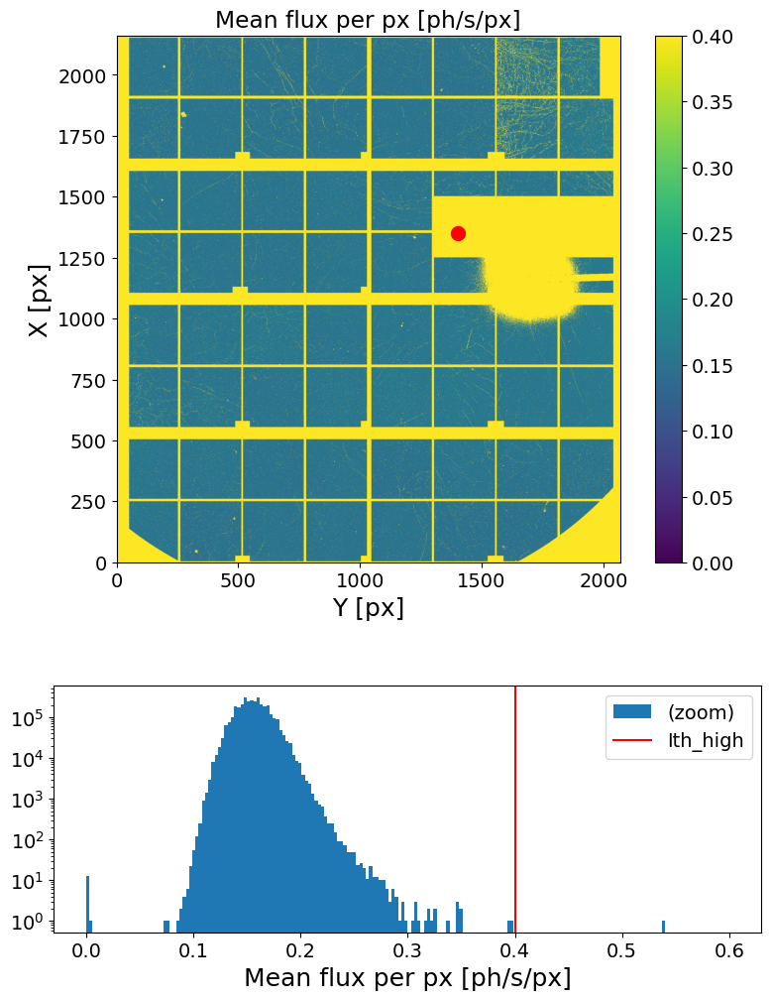

In [ ]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data[4], itime, Ith_high= .4, Nff=1_000_000, e4m_mask=mask)

### Intensity analysis

In [ ]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = {}, {}
for s in Nscan:
    t_It[s], It[s] = XPCS.get_It(e4m_data[s], itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
    np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(s).zfill(4), t_It=t_It[s], It=It[s])

100%|██████████| 1/1 [00:00<00:00, 94.08it/s]


<SecondaryAxis: >

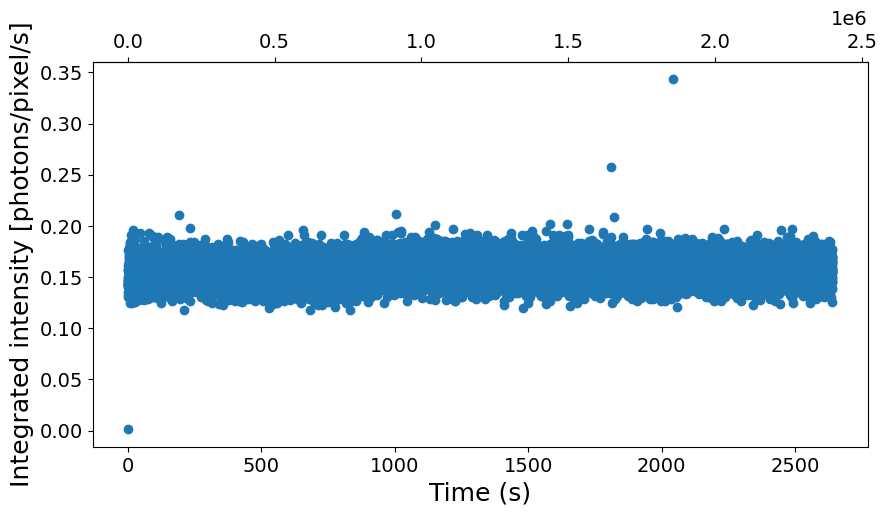

In [ ]:
plt.figure(figsize=(10,5))
for s in tqdm(Nscan):
    plt.scatter(t_It[s], It[s])

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))


### Correlation

In [ ]:
###################
Nfi = 1
Nff = None
Lbin = 5
Nbunch = 20
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1

G2t = np.zeros((e4m_data[Nscan[0]].shape[0]//Nbunch//Lbin, e4m_data[Nscan[0]].shape[0]//Nbunch//Lbin))
for s in tqdm(Nscan): G2t += XPCS.get_G2t_bybunch(e4m_data[s], mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)
G2t /= len(Nscan)

  0%|          | 0/1 [00:00<?, ?it/s]

Computing G2t for bunch 1 (Nfi = 1 , Nff = 120020 ) ...
Loading frames ...
Done! (elapsed time = 0.59 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 1.13 s)
	 | 24003 frames X 4471016 pixels
	 | sparsity = 8.00e-04
	 | memory usage (sparse.csr_array @ float64) = 0.959 GB
Masking data ...
Done! (elapsed time = 2.27 s)
	 | 24003 frames X 1424709 pixels
	 | sparsity = 8.57e-04
	 | memory usage (sparse.csr_array @ float64) = 0.328 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 3.12 s)
	 | 24003 X 24003 squared matrix
	 | memory usage (np.array @ float64) = 4.293 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 1.78 s)

Done!

Computing G2t for bunch 2 (Nfi = 120020 , Nff = 240039 ) ...
Loading frames ...
Done! (elapsed time = 0.57 s)
Binning frames (Lbin = 5, using MKL library) ...
Done! (elapsed time = 1.1 s)
	 | 24003 frames X 4471016 pixels
	 | sparsity = 7.94e-04
	 | memory usage (sparse.csr_array @ float64) = 0.952 GB
Maskin

100%|██████████| 1/1 [03:14<00:00, 194.08s/it]


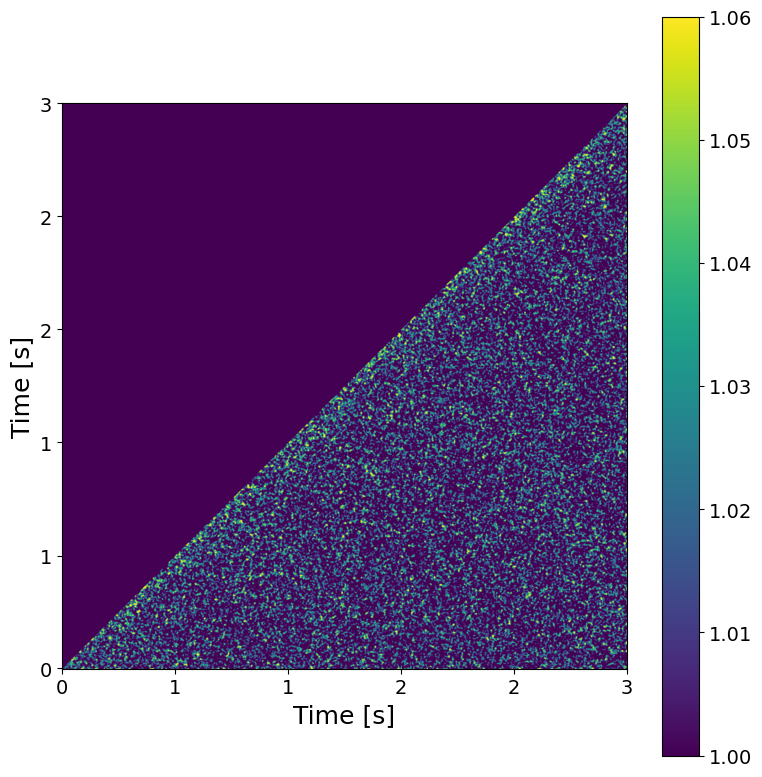

In [ ]:
############################
t1, t2 = 0, 3
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [ ]:
t, g2 = XPCS.get_g2(itime*Lbin, np.array(G2t), cython=False)
t_mt, g2_mt = XPCS.get_g2_mt(itime*Lbin, g2)

np.savez(g2_folder+'g2_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan[0])+'_'+str(Nscan[-1]), t=t, g2=g2, t_mt=t_mt, g2_mt=g2_mt)

Computing g2...
Done! (elapsed time = 0.81 s)



/tmp/ipykernel_268798/788206347.py:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


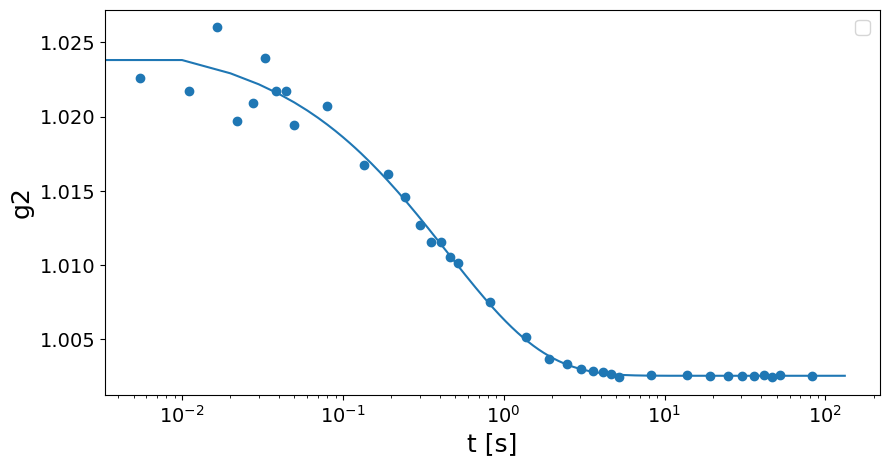

tau = 0.442041923610793 +/- 0.07490606021970282
beta = 0.71210042403651 +/- 0.0793880846487491
c = 0.022746952101665524 +/- 0.002136819274645384
y0 = 1.0025479984783192 +/- 2.8400852265200757e-05


In [ ]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'

#plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
plt.scatter(t_mt, g2_mt)

popt, pcov = curve_fit(decorelation_f, t[(t1_fit<t)*(t<t2_fit)], g2[(t1_fit<t)*(t<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
fit_out.loc[0] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]

x = np.arange(np.min(t), np.max(t), 1e-2)
y = decorelation_f(x, *popt)
plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan[0])+'-'+str(Nscan[-1])+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')

## XPCS mesh (T = 730C Q =  0.19 Å, 100 min @ 1ms (6_000_000 fm)) (GeO2_3, dataset 1, scan 4)

In [37]:
#######################################
sample_name = 'GeO2_3_730C'
Ndataset = 1
Nscan = range(4, 4+2)
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan[0])
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

#############################
command = mtimescan 0.001 1 1800288
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################



In [38]:
e4m_data = {}
for s in Nscan:
    e4m_data[s] = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, s)
    e4m_data[s] = COSMIC.fast_gamma_filter(e4m_data[s], Imaxth_high=5)

Loading sparse array ...


	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00012.h5 (13/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00013.h5 (14/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00014.h5 (15/

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  2 pixels (of 4471016 => 0.0 %)
################################################################################



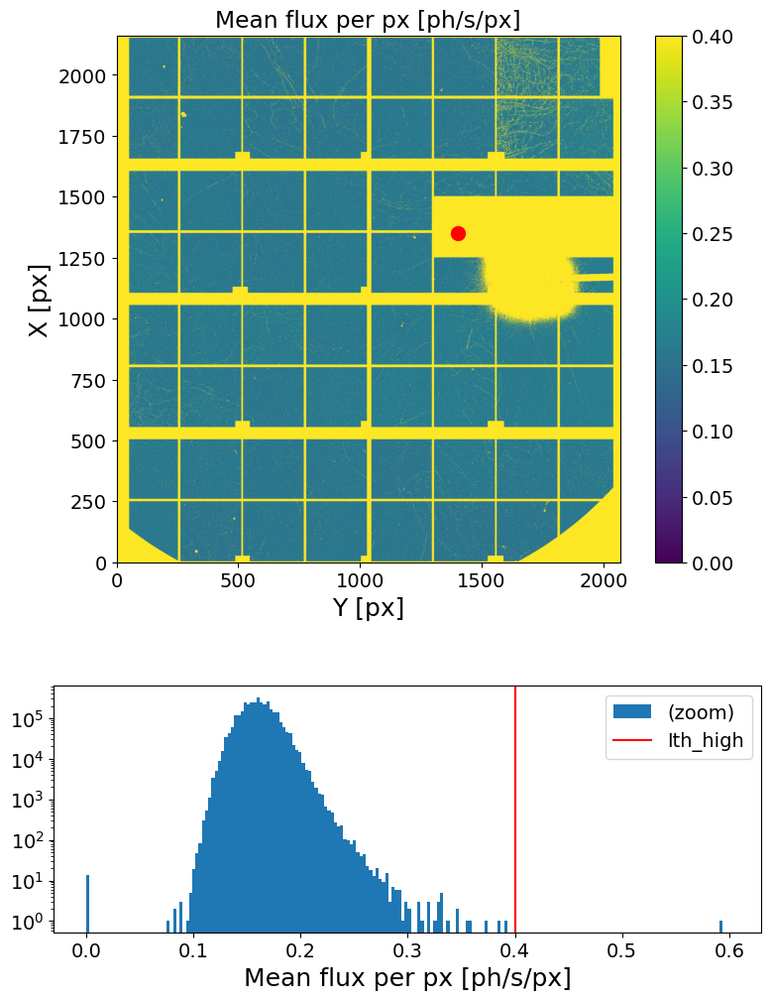

In [39]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data[4], itime, Ith_high= .4, Nff=1_000_000, e4m_mask=mask)

### Intensity analysis

In [40]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = {}, {}
for s in Nscan:
    t_It[s], It[s] = XPCS.get_It(e4m_data[s], itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
    np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(s).zfill(4), t_It=t_It[s], It=It[s])

100%|██████████| 2/2 [00:00<00:00, 127.56it/s]


<SecondaryAxis: >

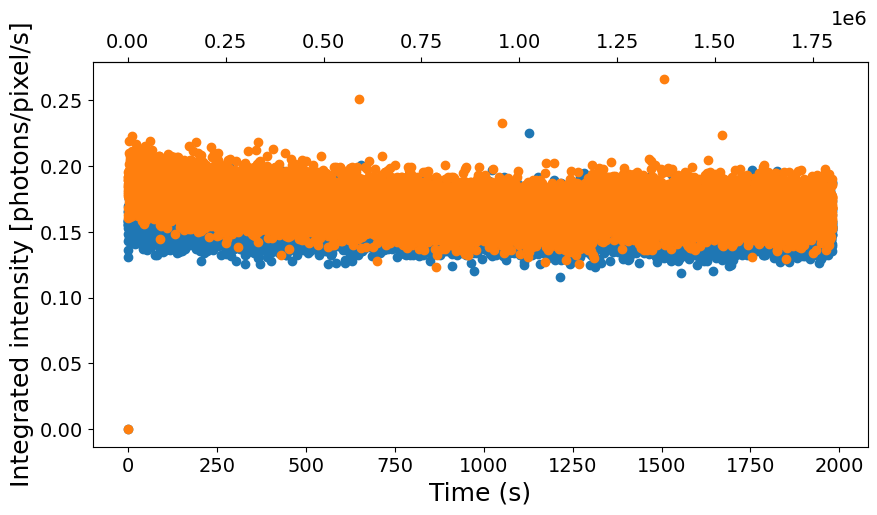

In [41]:
plt.figure(figsize=(10,5))
for s in tqdm(Nscan):
    plt.scatter(t_It[s], It[s])

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))


### Correlation

In [42]:
###################
Nfi = None
Nff = None
Lbin = 1
Nbunch = 50
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1
if Nfi is None: Nfi=0
if Nff is None: Nff=e4m_data[Nscan[0]].shape[0]

G2t = np.zeros(((Nff-Nfi)//Nbunch//Lbin, (Nff-Nfi)//Nbunch//Lbin))
for s in tqdm(Nscan): G2t += XPCS.get_G2t_bybunch(e4m_data[s], mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)
G2t /= len(Nscan)

  0%|          | 0/2 [00:00<?, ?it/s]

Computing G2t for bunch 1 (Nfi = 0 , Nff = 36005 ) ...
Loading frames ...
Done! (elapsed time = 0.38 s)
	 | 36005 frames X 4471016 pixels
	 | sparsity = 1.71e-04
	 | memory usage (sparse.csr_array @ uint8) = 0.23 GB
Masking data ...
Done! (elapsed time = 1.38 s)
	 | 36005 frames X 1424709 pixels
	 | sparsity = 1.81e-04
	 | memory usage (sparse.csr_array @ uint8) = 0.078 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 3.78 s)
	 | 36005 X 36005 squared matrix
	 | memory usage (np.array @ float64) = 9.659 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 3.34 s)

Done!

Computing G2t for bunch 2 (Nfi = 36005 , Nff = 72010 ) ...
Loading frames ...
Done! (elapsed time = 0.22 s)
	 | 36005 frames X 4471016 pixels
	 | sparsity = 1.69e-04
	 | memory usage (sparse.csr_array @ uint8) = 0.228 GB
Masking data ...
Done! (elapsed time = 0.64 s)
	 | 36005 frames X 1424709 pixels
	 | sparsity = 1.80e-04
	 | memory usage (sparse.csr_array @ uint8) = 0.078 GB
Computing G2t

 50%|█████     | 1/2 [09:26<09:26, 566.25s/it]

Computing G2t for bunch 1 (Nfi = 0 , Nff = 36005 ) ...
Loading frames ...
Done! (elapsed time = 0.21 s)
	 | 36005 frames X 4471016 pixels
	 | sparsity = 2.08e-04
	 | memory usage (sparse.csr_array @ uint8) = 0.281 GB
Masking data ...
Done! (elapsed time = 0.77 s)
	 | 36005 frames X 1424709 pixels
	 | sparsity = 2.03e-04
	 | memory usage (sparse.csr_array @ uint8) = 0.088 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 3.75 s)
	 | 36005 X 36005 squared matrix
	 | memory usage (np.array @ float64) = 9.659 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 4.84 s)

Done!

Computing G2t for bunch 2 (Nfi = 36005 , Nff = 72010 ) ...
Loading frames ...
Done! (elapsed time = 0.2 s)
	 | 36005 frames X 4471016 pixels
	 | sparsity = 2.05e-04
	 | memory usage (sparse.csr_array @ uint8) = 0.277 GB
Masking data ...
Done! (elapsed time = 0.68 s)
	 | 36005 frames X 1424709 pixels
	 | sparsity = 2.01e-04
	 | memory usage (sparse.csr_array @ uint8) = 0.087 GB
Computing G2t

100%|██████████| 2/2 [18:52<00:00, 566.39s/it]


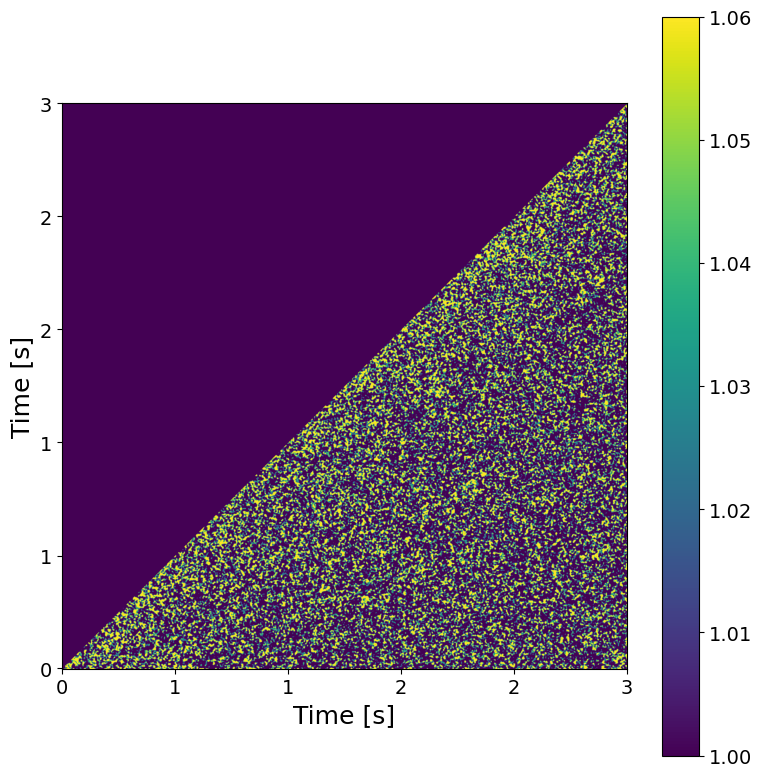

In [43]:
############################
t1, t2 = 0, 3
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [44]:
t, g2 = XPCS.get_g2(itime*Lbin, np.array(G2t), cython=False)
t_mt, g2_mt = XPCS.get_g2_mt(itime*Lbin, g2)

np.savez(g2_folder+'g2_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan[0])+'_'+str(Nscan[-1]), t=t, g2=g2, t_mt=t_mt, g2_mt=g2_mt)

Computing g2...
Done! (elapsed time = 2.18 s)



/tmp/ipykernel_269951/2644279950.py:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


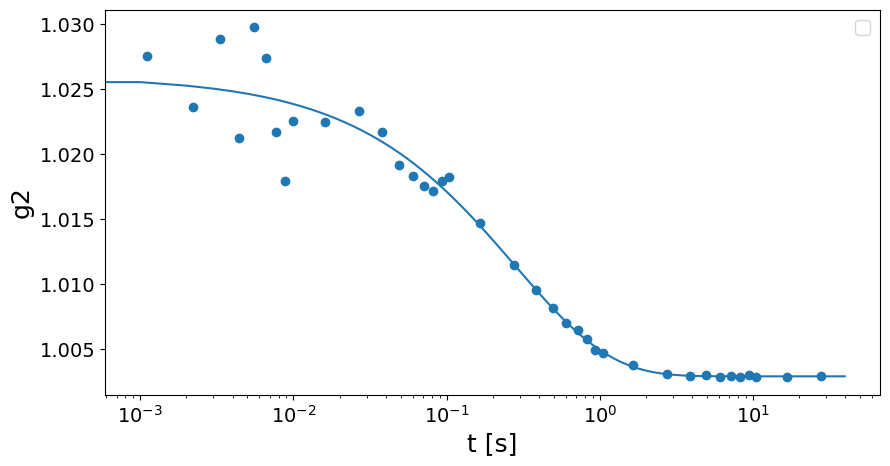

tau = 0.2804408423944792 +/- 0.04690150052056333
beta = 0.7004266058176478 +/- 0.07604027330402537
c = 0.02306064842401215 +/- 0.00210982615045792
y0 = 1.002928459909158 +/- 4.247794968888032e-05


In [46]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'

#plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
plt.scatter(t_mt, g2_mt)

popt, pcov = curve_fit(decorelation_f, t[(t1_fit<t)*(t<t2_fit)], g2[(t1_fit<t)*(t<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
fit_out.loc[0] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]

x = np.arange(np.min(t), np.max(t), 1e-3)
y = decorelation_f(x, *popt)
plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan[0])+'-'+str(Nscan[-1])+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')

## XPCS mesh (T = 730C Q =  0.19 Å, 100 min @ 1ms (6_000_000 fm)) (GeO2_3_att2, dataset 1, scan 4)

In [8]:
#######################################
sample_name = 'GeO2_3_730C_att2'
Ndataset = 1
Nscan = range(4, 4+2)
#######################################

scan = ID10.load_scan(raw_folder, sample_name, Ndataset, Nscan[0])
Ei = scan['monoe']
itime = scan['fast_timer_period'][0]
theta = scan['delcoup']
Q = round(XPCS.theta2Q(Ei,  theta),2)

print('#############################')
print('command =', scan['command'])
print('itime =', itime)
print('theta =', theta)
print('Q =', Q)
print('#############################\n')

#############################
command = mtimescan 0.001 1 1800288
itime = 0.0011
theta = 1.7500000000000004
Q = 0.15
#############################



In [9]:
e4m_data = {}
for s in Nscan:
    e4m_data[s] = ID10.load_sparse_e4m(raw_folder, sample_name, Ndataset, s)
    e4m_data[s] = COSMIC.fast_gamma_filter(e4m_data[s], Imaxth_high=5)

Loading sparse array ...


	 -> loading file eiger4m_v2_sparse_frame_0_00000.h5 (1/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00002.h5 (3/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00003.h5 (4/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00004.h5 (5/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00001.h5 (2/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00005.h5 (6/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00008.h5 (9/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00006.h5 (7/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00007.h5 (8/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00010.h5 (11/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00009.h5 (10/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00011.h5 (12/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00012.h5 (13/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00013.h5 (14/361 loops)
	 -> loading file eiger4m_v2_sparse_frame_0_00014.h5 (15/

### Flux check

################################################################################
Maximum count in the hull run -> 5
# of pixels above Ith_high treshold ->  0 pixels (of 4471016 => 0.0 %)
################################################################################



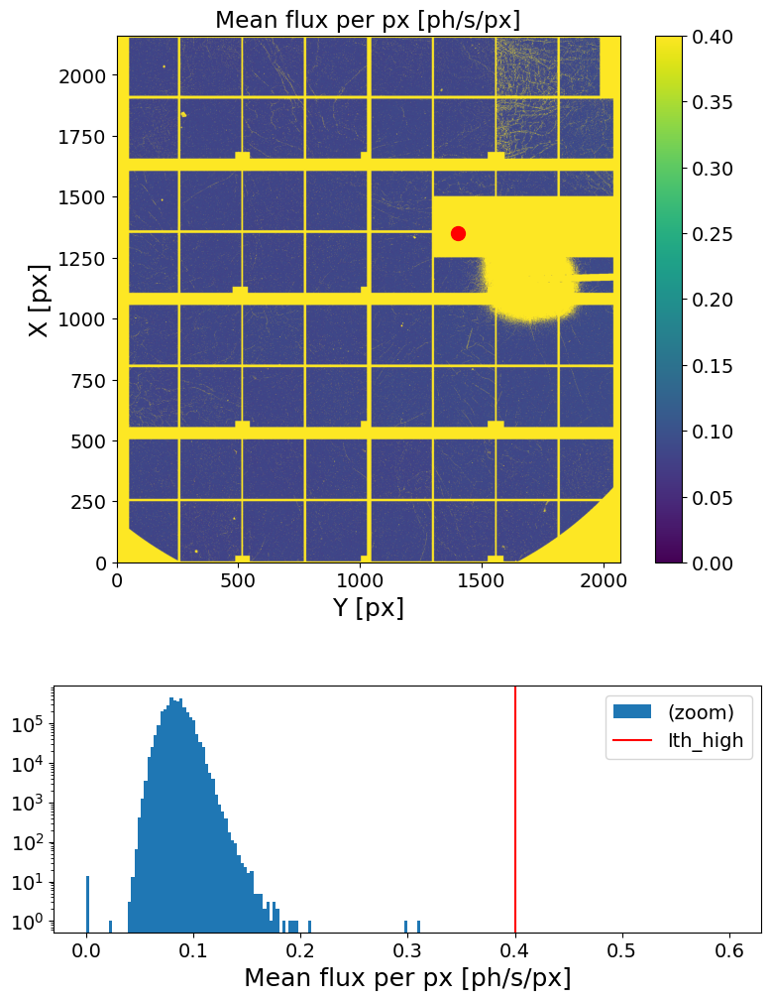

In [10]:
#############################################
mask = e4m_mask * e4m_htmask * bs_mask
#############################################

XPCS.gen_plots4mask(e4m_data[4], itime, Ith_high= .4, Nff=1_000_000, e4m_mask=mask)

### Intensity analysis

In [11]:
####################
Lbin = 1
Nstep = 100
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
####################

t_It, It = {}, {}
for s in Nscan:
    t_It[s], It[s] = XPCS.get_It(e4m_data[s], itime, mask=mask, Lbin=Lbin, Nstep=Nstep)
    np.savez(Idts_folder+'Idt_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(s).zfill(4), t_It=t_It[s], It=It[s])

100%|██████████| 2/2 [00:00<00:00, 97.43it/s]


<SecondaryAxis: >

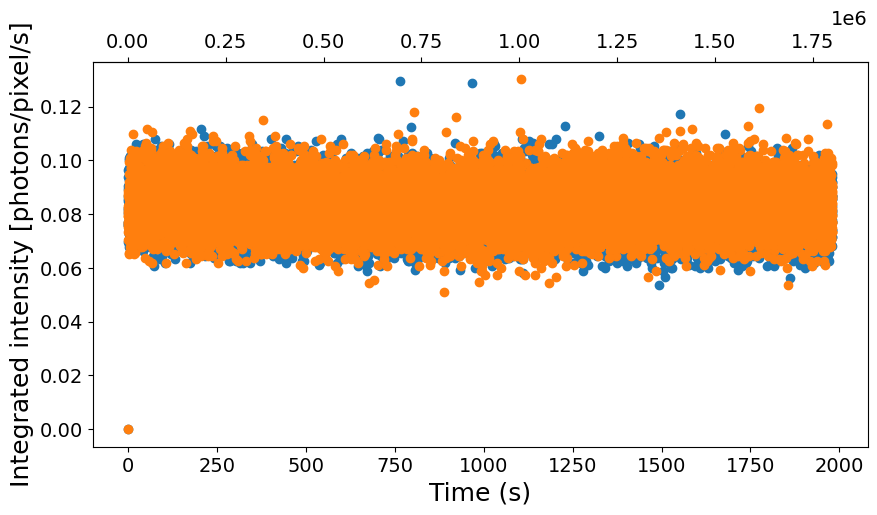

In [12]:
plt.figure(figsize=(10,5))
for s in tqdm(Nscan):
    plt.scatter(t_It[s], It[s])

plt.xlabel('Time (s)')
plt.ylabel('Integrated intensity [photons/pixel/s]')
plt.gca().secondary_xaxis('top', functions=(lambda x: x/itime, lambda x: x*itime))


### Correlation

In [13]:
###################
Nfi = None
Nff = None
Lbin = 1
Nbunch = 50
mask = e4m_mask * e4m_htmask * bs_mask * Qmask
###################
if Lbin is None: Lbin=1
if Nfi is None: Nfi=0
if Nff is None: Nff=e4m_data[Nscan[0]].shape[0]

G2t = np.zeros(((Nff-Nfi)//Nbunch//Lbin, (Nff-Nfi)//Nbunch//Lbin))
for s in tqdm(Nscan): G2t += XPCS.get_G2t_bybunch(e4m_data[s], mask=mask, Nfi=Nfi, Nff=Nff, Lbin=Lbin, Nbunch=Nbunch)
G2t /= len(Nscan)

  0%|          | 0/2 [00:00<?, ?it/s]

Computing G2t for bunch 1 (Nfi = 0 , Nff = 36005 ) ...
Loading frames ...
Done! (elapsed time = 0.17 s)
	 | 36005 frames X 4471016 pixels
	 | sparsity = 8.79e-05
	 | memory usage (sparse.csr_array @ uint8) = 0.119 GB
Masking data ...
Done! (elapsed time = 1.03 s)
	 | 36005 frames X 1424709 pixels
	 | sparsity = 9.27e-05
	 | memory usage (sparse.csr_array @ uint8) = 0.04 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 3.81 s)
	 | 36005 X 36005 squared matrix
	 | memory usage (np.array @ float64) = 9.659 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 3.47 s)

Done!

Computing G2t for bunch 2 (Nfi = 36005 , Nff = 72010 ) ...
Loading frames ...
Done! (elapsed time = 0.13 s)
	 | 36005 frames X 4471016 pixels
	 | sparsity = 8.80e-05
	 | memory usage (sparse.csr_array @ uint8) = 0.119 GB
Masking data ...
Done! (elapsed time = 0.66 s)
	 | 36005 frames X 1424709 pixels
	 | sparsity = 9.30e-05
	 | memory usage (sparse.csr_array @ uint8) = 0.04 GB
Computing G2t 

 50%|█████     | 1/2 [08:59<08:59, 539.80s/it]

Computing G2t for bunch 1 (Nfi = 0 , Nff = 36005 ) ...
Loading frames ...
Done! (elapsed time = 0.1 s)
	 | 36005 frames X 4471016 pixels
	 | sparsity = 8.99e-05
	 | memory usage (sparse.csr_array @ uint8) = 0.122 GB
Masking data ...
Done! (elapsed time = 0.45 s)
	 | 36005 frames X 1424709 pixels
	 | sparsity = 9.33e-05
	 | memory usage (sparse.csr_array @ uint8) = 0.04 GB
Computing G2t (using MKL library)...
Done! (elapsed time = 3.64 s)
	 | 36005 X 36005 squared matrix
	 | memory usage (np.array @ float64) = 9.659 GB
Normalizing G2t (using NumExpr library)...
Done! (elapsed time = 5.48 s)

Done!

Computing G2t for bunch 2 (Nfi = 36005 , Nff = 72010 ) ...
Loading frames ...
Done! (elapsed time = 0.1 s)
	 | 36005 frames X 4471016 pixels
	 | sparsity = 9.00e-05
	 | memory usage (sparse.csr_array @ uint8) = 0.122 GB
Masking data ...
Done! (elapsed time = 0.5 s)
	 | 36005 frames X 1424709 pixels
	 | sparsity = 9.35e-05
	 | memory usage (sparse.csr_array @ uint8) = 0.04 GB
Computing G2t (us

100%|██████████| 2/2 [17:58<00:00, 539.30s/it]


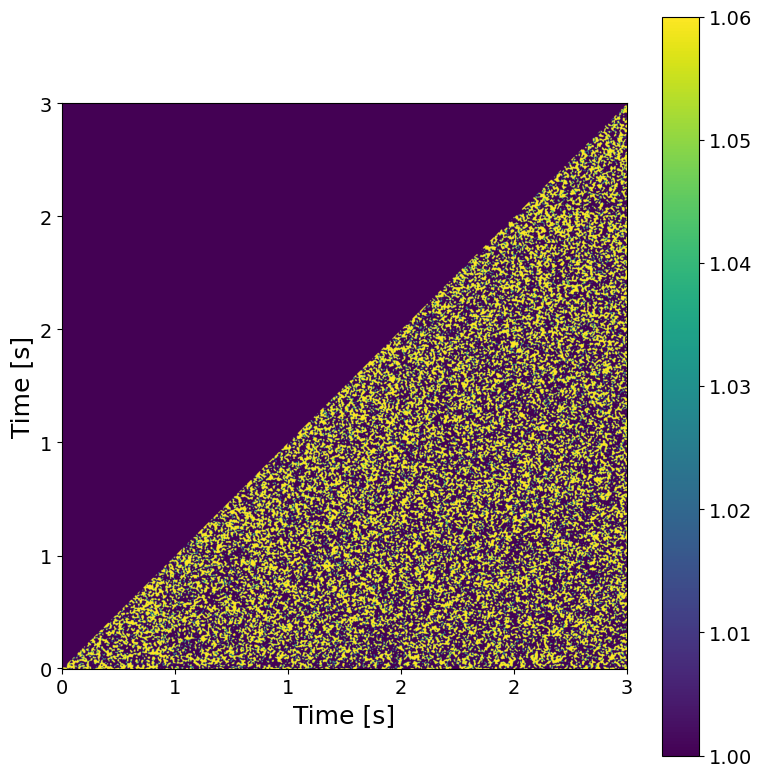

In [14]:
############################
t1, t2 = 0, 3
vmin, vmax = 1.0, 1.06
############################
XPCS.plot_G2t(G2t, vmin, vmax, itime=itime, t1=t1, t2=t2, sigma_filter=3)

In [15]:
t, g2 = XPCS.get_g2(itime*Lbin, np.array(G2t), cython=False)
t_mt, g2_mt = XPCS.get_g2_mt(itime*Lbin, g2)

np.savez(g2_folder+'g2_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan[0])+'_'+str(Nscan[-1]), t=t, g2=g2, t_mt=t_mt, g2_mt=g2_mt)

Computing g2...
Done! (elapsed time = 2.16 s)



/tmp/ipykernel_282203/2644279950.py:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


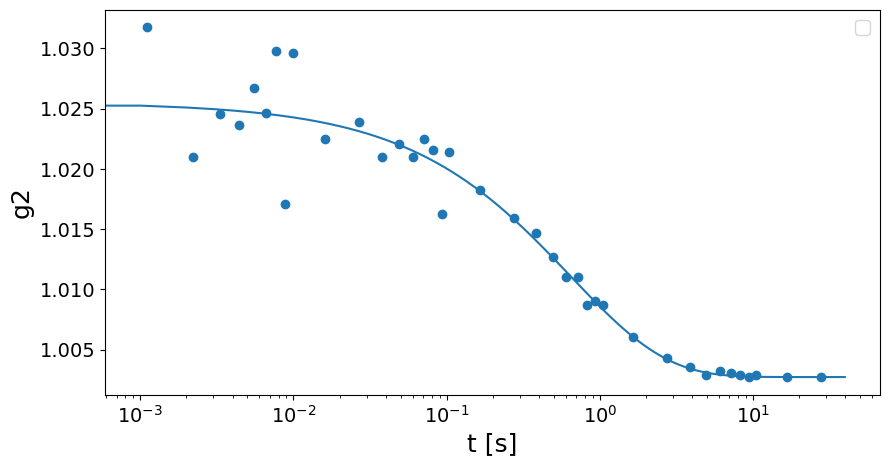

tau = 0.6416927930692835 +/- 0.15424973682805895
beta = 0.6941442819280007 +/- 0.10880978990693972
c = 0.0227918556792415 +/- 0.002995936159829201
y0 = 1.0027120374821932 +/- 9.651319332164134e-05


In [16]:
##################
t1_fit = 0
t2_fit = 1e8
##################
 
plt.figure(figsize=(10,5))
fit_out = pd.DataFrame(columns=['tau', 'beta', 'c', 'y0', 'dtau', 'dbeta', 'dc', 'dy0'])
fit_out.index.name = 't'

#plt.scatter(t[k], g2[k], s=1, label = str(k)+'s')
plt.scatter(t_mt, g2_mt)

popt, pcov = curve_fit(decorelation_f, t[(t1_fit<t)*(t<t2_fit)], g2[(t1_fit<t)*(t<t2_fit)], p0=[3, .7, .02, 1], bounds=([0, 0, 0, 0], [np.inf, np.inf, np.inf, np.inf]))
fit_out.loc[0] = [popt[0], popt[1], popt[2], popt[3], np.sqrt(pcov[0,0]), np.sqrt(pcov[1,1]), np.sqrt(pcov[2,2]), np.sqrt(pcov[3,3])]

x = np.arange(np.min(t), np.max(t), 1e-3)
y = decorelation_f(x, *popt)
plt.plot(x, y,)

fit_out.to_csv(fit_outs_folder+'fit_out_'+sample_name+'_'+str(Ndataset).zfill(4)+'_'+str(Nscan[0])+'-'+str(Nscan[-1])+'.csv')

plt.xlabel('t [s]')
plt.ylabel('g2')
plt.xscale('log')
plt.legend()
plt.show()

print(f'tau = {popt[0]} +/- {np.sqrt(pcov[0,0])}')
print(f'beta = {popt[1]} +/- {np.sqrt(pcov[1,1])}')
print(f'c = {popt[2]} +/- {np.sqrt(pcov[2,2])}')
print(f'y0 = {popt[3]} +/- {np.sqrt(pcov[3,3])}')